# Text-to-Image Generation with Stable Diffusion and CLIP

**Project Overview:**
- Fine-tune Stable Diffusion v1.4 on COCO dataset
- Use CLIP for text encoding and semantic understanding
- Comprehensive evaluation with multiple schedulers and guidance scales
- Calculate FID (Fréchet Inception Distance) and IS (Inception Score) metrics

**Key Components:**
1. Data preprocessing and domain-specific filtering
2. CLIP text embeddings generation
3. Stable Diffusion fine-tuning
4. Scheduler comparison (DPM, PNDM, Euler, DDIM)
5. Evaluation metrics computation
6. Model deployment and custom generation

---
# 1. ENVIRONMENT SETUP
---
Initialize working environment, import required libraries, and verify package versions

In [6]:
# Core Python libraries for system operations and data handling
import sys, os
import importlib
import site
import json
import random
from datetime import datetime
from IPython.display import display, Markdown


# Add user site packages to Python path for custom installations
user_site = os.path.expanduser("~/.local/lib/python3.10/site-packages")
if user_site not in sys.path:
    sys.path.append(user_site)
print(" Core libraries imported")
print(f" Working directory: {os.getcwd()}")

print("All packages installed")
importlib.reload(site)
from PIL import Image      # Image manipulation
from tqdm import tqdm      # Progress bars
import numpy as np
import matplotlib.pyplot as plt
try:
    import torch
    import kagglehub
    from transformers import CLIPTokenizer, CLIPTextModel, CLIPProcessor, CLIPModel
    from sklearn.metrics.pairwise import cosine_similarity
    from diffusers import (
        StableDiffusionPipeline,
        DPMSolverMultistepScheduler,
        PNDMScheduler,
        EulerDiscreteScheduler,
        DDIMScheduler
    )
    import diffusers
    import transformers

    # Display package versions for reproducibility
    print(" PyTorch version:", torch.__version__)
    print(" Diffusers version:", diffusers.__version__)
    print(" Transformers version:", transformers.__version__)
except Exception as e:
    print(" Error importing packages:", e)

 Core libraries imported
 Working directory: /content
All packages installed


Flax classes are deprecated and will be removed in Diffusers v1.0.0. We recommend migrating to PyTorch classes or pinning your version of Diffusers.
Flax classes are deprecated and will be removed in Diffusers v1.0.0. We recommend migrating to PyTorch classes or pinning your version of Diffusers.


 PyTorch version: 2.9.0+cu126
 Diffusers version: 0.36.0
 Transformers version: 4.57.3


---
# 2. DATASET ACQUISITION
---
Download COCO dataset and configure GPU acceleration

In [7]:
# ============================================================
# GPU CONFIGURATION
# ============================================================
# Check GPU availability and set compute device
# CUDA acceleration significantly speeds up image generation

if torch.cuda.is_available():
    print(" GPU is available:", torch.cuda.get_device_name(0))
    print(f"   CUDA version: {torch.version.cuda}")
    device = "cuda"
else:
    print("GPU not available. Using CPU.")
    device = "cpu"
DEVICE = device
print(f" Device set to: {DEVICE}")


# ============================================================
# COCO DATASET DOWNLOAD
# ============================================================
# COCO (Common Objects in Context) contains:
# - 330K images with diverse scenes
# - Multiple captions per image (human-annotated)
# - Rich semantic information for training

print("\n DOWNLOADING COCO DATASET")
print("=" * 60)

print("Downloading COCO dataset via kagglehub...")
dataset_path = kagglehub.dataset_download("nikhil7280/coco-image-caption")
print(f"Dataset downloaded to: {dataset_path}")

DATASET_ROOT = dataset_path

 GPU is available: Tesla T4
   CUDA version: 12.6
 Device set to: cuda

 DOWNLOADING COCO DATASET
Using Colab cache for faster access to the 'coco-image-caption' dataset.
Dataset downloaded to: /kaggle/input/coco-image-caption


In [8]:
# ============================================================
# DATASET STRUCTURE EXPLORATION
# ============================================================
# Understand the organization of COCO dataset:
# - train2014/ : Training images from 2014

print("\nEXPLORING DATASET STRUCTURE")
print("=" * 60)

for root, dirs, files in os.walk(DATASET_ROOT):
    level = root.replace(DATASET_ROOT, '').count(os.sep)
    if level > 2:  # Limit depth
        continue
    indent = ' ' * 2 * level
    print(f"{indent} {os.path.basename(root)}/")
    subindent = ' ' * 2 * (level + 1)

    for d in dirs[:3]:
        print(f"{subindent} {d}/")

    for f in files[:3]:
        print(f"{subindent} {f}")


EXPLORING DATASET STRUCTURE
 coco-image-caption/
   annotations_trainval2014/
   val2017/
   annotations_trainval2017/
   annotations_trainval2014/
     annotations/
     annotations/
       captions_train2014.json
       instances_train2014.json
       instances_val2014.json
   val2017/
     val2017/
     val2017/
       000000011197.jpg
       000000219485.jpg
       000000151000.jpg
   annotations_trainval2017/
     annotations/
     annotations/
       person_keypoints_train2017.json
       instances_val2017.json
       instances_train2017.json
   train2014/
     train2014/
     train2014/
       COCO_train2014_000000263229.jpg
       COCO_train2014_000000381595.jpg
       COCO_train2014_000000147733.jpg


In [9]:
# ============================================================
# LOCATE DATASET COMPONENTS
# ============================================================

print("\n LOCATING DATASET COMPONENTS")
print("=" * 60)

caption_file = None
img_dir = None


# Search for caption annotation file
for root, dirs, files in os.walk(DATASET_ROOT):
    for file in files:
        if "captions_train2014.json" in file:
            caption_file = os.path.join(root, file)
            break
    if caption_file:
        break

# Search for image directory containing JPG/PNG files
for root, dirs, files in os.walk(DATASET_ROOT):
    if "train2014" in dirs:
        potential_dir = os.path.join(root, "train2014")
        if os.path.exists(potential_dir):
            sample_files = os.listdir(potential_dir)[:10]
            if any(f.endswith(('.jpg', '.png', '.JPEG')) for f in sample_files):
                img_dir = potential_dir
                break

print(f" Captions file: {caption_file}")
print(f" Images directory: {img_dir}")

if not caption_file or not img_dir:
    print(" ERROR: Dataset components not found!")
else:
    print(f" Dataset ready for processing")


 LOCATING DATASET COMPONENTS
 Captions file: /kaggle/input/coco-image-caption/annotations_trainval2014/annotations/captions_train2014.json
 Images directory: /kaggle/input/coco-image-caption/train2014/train2014
 Dataset ready for processing


---
# 3. DATA PREPROCESSING
---
Load captions, select domain-specific subset, and preprocess images

In [10]:
# ============================================================
# LOAD IMAGE-CAPTION PAIRS
# ============================================================

print("\n LOADING CAPTION-IMAGE PAIRS")
print("=" * 60)

# Load JSON annotations
with open(caption_file, "r") as f:
    captions_data = json.load(f)

# Create mapping from image ID to filename
id_to_filename = {img["id"]: img["file_name"] for img in captions_data["images"]}

# Build list of image-caption pairs
pairs = []
for ann in captions_data["annotations"]:
    image_id = ann["image_id"]
    if image_id in id_to_filename:
        pairs.append({
            "image_path": os.path.join(img_dir, id_to_filename[image_id]),
            "caption": ann["caption"]
        })

print(f" Loaded {len(pairs)} image-caption pairs")
print(f" Example: {pairs[0]['caption'][:100]}...")


 LOADING CAPTION-IMAGE PAIRS
 Loaded 414113 image-caption pairs
 Example: A very clean and well decorated empty bathroom...


## 3.1 Domain-Specific Filtering
CHOOSING SUBSET OF IMAGES

In [11]:
# ============================================================
# DOMAIN SELECTION FOR FOCUSED TRAINING
# ============================================================

print("\n DOMAIN SELECTION FOR FOCUSED TRAINING")
print("=" * 60)


DOMAINS = {
    "1": {"name": "animals", "keywords": ["dog", "cat", "bird", "horse", "elephant", "bear", "zebra", "animal"]},
    "2": {"name": "vehicles", "keywords": ["car", "truck", "bus", "train", "airplane", "boat", "motorcycle", "vehicle"]},
    "3": {"name": "food", "keywords": ["pizza", "donut", "cake", "sandwich", "apple", "banana", "food", "eating"]},
    "4": {"name": "sports", "keywords": ["ball", "tennis", "soccer", "basketball", "skateboard", "sport", "playing"]},
    "5": {"name": "indoor", "keywords": ["couch", "bed", "table", "chair", "tv", "laptop", "room", "kitchen"]}
}

# Display available domains
print("Available domains:")
for key, domain in DOMAINS.items():
    print(f"  [{key}] {domain['name'].upper()}")

# User selects domain
choice = input("\n Enter domain number (1-5) or 'all' for general: ").strip()

if choice.lower() == 'all':
    print("\n CREATING GENERAL SUBSET FOR PROCESSING")
    print("=" * 60)
    SUBSET_SIZE = 4000
    random.seed(42)
    subset = random.sample(pairs, min(SUBSET_SIZE, len(pairs)))
else:

    domain_keywords = DOMAINS[choice]["keywords"]
    domain_name = DOMAINS[choice]["name"]

    print(f"\n FILTERING FOR {domain_name.upper()} DOMAIN")
    print("=" * 60)


    domain_pairs = []
    for pair in pairs:
        caption_lower = pair["caption"].lower()
        if any(keyword in caption_lower for keyword in domain_keywords):
            domain_pairs.append(pair)

    print(f"Found {len(domain_pairs)} {domain_name} images in dataset")

    # Sample subset for training efficiency
    SUBSET_SIZE = min(4000, len(domain_pairs))
    random.seed(42)
    subset = random.sample(domain_pairs, SUBSET_SIZE)

    print(f"Selected {len(subset)} {domain_name} samples for processing")

# Create directory structure for processed data
os.makedirs("data/processed", exist_ok=True)
os.makedirs("data/processed/images", exist_ok=True)
os.makedirs("data/processed/embeddings", exist_ok=True)
os.makedirs("data/generated_samples", exist_ok=True)
print(f" Created directory structure")


 DOMAIN SELECTION FOR FOCUSED TRAINING
Available domains:
  [1] ANIMALS
  [2] VEHICLES
  [3] FOOD
  [4] SPORTS
  [5] INDOOR

 Enter domain number (1-5) or 'all' for general: all

 CREATING GENERAL SUBSET FOR PROCESSING
 Created directory structure


In [12]:
# ============================================================
# PROCESSING AND RESIZING IMAGES
# ============================================================

print("\n PROCESSING AND RESIZING IMAGES")
print("=" * 60)

import shutil
from PIL import Image

processed_dir = "data/processed/images"
if os.path.exists(processed_dir) and len(os.listdir(processed_dir)) > 0:
    print(f" Clearing existing processed images...")
    shutil.rmtree(processed_dir)
    os.makedirs(processed_dir)

saved_count = 0
subset_clean = []

for item in tqdm(subset, desc="Processing images"):
    img_path = item["image_path"]
    if not os.path.exists(img_path):
        continue

    try:
        img = Image.open(img_path).convert("RGB")
        img = img.resize((256, 256))
        save_path = os.path.join(processed_dir, os.path.basename(img_path))
        img.save(save_path)


        new_item = item.copy()
        new_item["image_path"] = save_path
        subset_clean.append(new_item)
        saved_count += 1
    except Exception as e:
        continue

print(f" Processed {saved_count} images → {processed_dir}")


 PROCESSING AND RESIZING IMAGES


Processing images: 100%|██████████| 4000/4000 [00:57<00:00, 69.20it/s]

 Processed 4000 images → data/processed/images


In [13]:
# ============================================================
# SAVE METADATA
# ============================================================

print("\n SAVING METADATA")
print("=" * 60)

captions_json = "data/processed/captions_subset.json"
with open(captions_json, "w") as f:
    json.dump(subset_clean, f, indent=2)

print(f" Metadata saved: {captions_json}")
print(f" Final dataset: {len(subset_clean)} pairs")


 SAVING METADATA
 Metadata saved: data/processed/captions_subset.json
 Final dataset: 4000 pairs


---
# 4. CLIP TEXT ENCODING
---
Generate semantic text embeddings using CLIP (Contrastive Language-Image Pre-training)

In [14]:
# ============================================================
# LOAD CLIP MODEL
# ============================================================

print("\n LOADING CLIP MODEL")
print("=" * 60)

model_name = "openai/clip-vit-base-patch32"
print(f" Loading: {model_name}")

# Load CLIP components
tokenizer = CLIPTokenizer.from_pretrained(model_name)
text_model = CLIPTextModel.from_pretrained(model_name).to(DEVICE)
text_model.eval() # Set to evaluation mode

print(f" CLIP model loaded on {DEVICE}")
print(f" Parameters: {sum(p.numel() for p in text_model.parameters())/1e6:.2f}M")


 LOADING CLIP MODEL
 Loading: openai/clip-vit-base-patch32


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

config.json: 0.00B [00:00, ?B/s]

pytorch_model.bin:   0%|          | 0.00/605M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/605M [00:00<?, ?B/s]

 CLIP model loaded on cuda
 Parameters: 63.17M


## 4.1 Generate Text Embeddings
Convert captions to dense vector representations

In [15]:
# ============================================================
# GENERATING TEXT EMBEDDINGS
# ============================================================

print("\n GENERATING TEXT EMBEDDINGS")
print("=" * 60)

def encode_text_batch(texts, max_length=77):
    """Encode text to embeddings using CLIP"""
    inputs = tokenizer(
        texts,
        padding="max_length",
        truncation=True,
        max_length=max_length,
        return_tensors="pt"
    ).to(DEVICE)

    with torch.no_grad():
        outputs = text_model(**inputs)
        hidden = outputs.last_hidden_state
        mask = inputs["attention_mask"].unsqueeze(-1)
        pooled = (hidden * mask).sum(dim=1) / mask.sum(dim=1).clamp(min=1e-9)

    return pooled.cpu().numpy()


with open(captions_json, "r") as f:
    caption_data = json.load(f)

# Generate embeddings in batches
BATCH_SIZE = 64
all_embeddings = []
metadata = []

for i in tqdm(range(0, len(caption_data), BATCH_SIZE), desc="Encoding batches"):
    batch = caption_data[i:i+BATCH_SIZE]
    texts = [x["caption"] for x in batch]
    embeddings_batch = encode_text_batch(texts)
    all_embeddings.append(embeddings_batch)

    for j, item in enumerate(batch):
        metadata.append({
            "idx": i+j,
            "image_path": item["image_path"],
            "caption": item["caption"]
        })

# Concatenate all batches
embeddings = np.vstack(all_embeddings)
emb_dir = "data/processed/embeddings"

np.save(os.path.join(emb_dir, "text_embeddings.npy"), embeddings)
with open(os.path.join(emb_dir, "text_index.json"), "w") as f:
    json.dump(metadata, f, indent=2)

print(f" Embeddings shape: {embeddings.shape}")
print(f" Saved to {emb_dir}")



 GENERATING TEXT EMBEDDINGS



Encoding batches: 100%|██████████| 63/63 [00:09<00:00,  6.42it/s]


 Embeddings shape: (4000, 512)
 Saved to data/processed/embeddings


In [16]:

print("\n VERIFYING EMBEDDINGS")
print("=" * 60)
from sklearn.metrics.pairwise import cosine_similarity

sample_sims = cosine_similarity(embeddings[0:1], embeddings[1:6])[0]
print("Cosine similarities (caption 0 vs next 5):")
for i, sim in enumerate(sample_sims, 1):
    print(f"  Caption {i}: {sim:.4f}")

env_info = {
    "model": model_name,
    "num_samples": len(caption_data),
    "embedding_shape": list(embeddings.shape),
    "device": DEVICE,
    "timestamp": datetime.now().isoformat()
}

with open(os.path.join(emb_dir, "env_info.json"), "w") as f:
    json.dump(env_info, f, indent=2)

print(f" Embeddings verified and environment saved")



 VERIFYING EMBEDDINGS
Cosine similarities (caption 0 vs next 5):
  Caption 1: 0.4702
  Caption 2: 0.6369
  Caption 3: 0.5926
  Caption 4: 0.5542
  Caption 5: 0.5060
 Embeddings verified and environment saved


---
# 5. STABLE DIFFUSION PIPELINE
---
Load pre-trained Stable Diffusion model and generate initial samples


 LOADING STABLE DIFFUSION
 Loading: CompVis/stable-diffusion-v1-4


model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 14 files:   0%|          | 0/14 [00:00<?, ?it/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

scheduler_config-checkpoint.json:   0%|          | 0.00/209 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/313 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/551 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


 Pipeline loaded on cuda
 Memory optimization: Enabled

 GENERATING TEST IMAGES - MILESTONE 1

 Prompt 1/5: "A golden retriever playing fetch on a sunny beach..."
   Generating...

  0%|          | 0/25 [00:00<?, ?it/s]

  Done! (6.4s)

 Prompt 2/5: "A cozy coffee shop interior with warm lighting..."
   Generating...

  0%|          | 0/25 [00:00<?, ?it/s]

  Done! (5.1s)

 Prompt 3/5: "A futuristic city skyline at night with neon light..."
   Generating...

  0%|          | 0/25 [00:00<?, ?it/s]

  Done! (5.4s)

 Prompt 4/5: "A serene mountain landscape with lake reflection..."
   Generating...

  0%|          | 0/25 [00:00<?, ?it/s]

  Done! (5.0s)

 Prompt 5/5: "Fresh sushi on a wooden plate with chopsticks..."
   Generating...

  0%|          | 0/25 [00:00<?, ?it/s]

  Done! (5.0s)

 Generated 5 test images


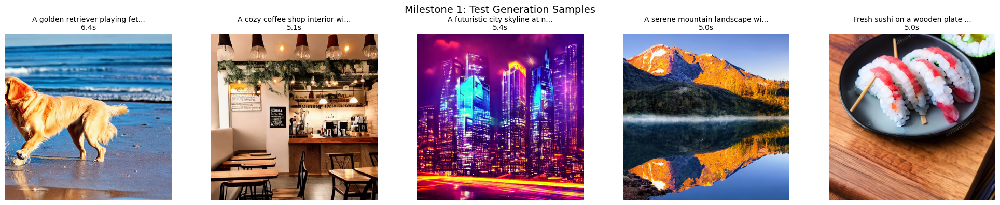

In [17]:
# ============================================================
# LOAD STABLE DIFFUSION MODEL
# ============================================================
# Stable Diffusion v1.4:
# - Text-to-image generation model
# - Uses latent diffusion in compressed space
# - Components: VAE, UNet, Text Encoder (CLIP)
# Architecture:
# Text → CLIP → Embeddings → UNet (iterative denoising) → VAE Decoder → Image


print("\n LOADING STABLE DIFFUSION")
print("=" * 60)

model_id = "CompVis/stable-diffusion-v1-4"
print(f" Loading: {model_id}")

# Enable memory optimization
pipe = StableDiffusionPipeline.from_pretrained(
    model_id,
    torch_dtype=torch.float16 if DEVICE == "cuda" else torch.float32,
    safety_checker=None,
    requires_safety_checker=False
)
pipe = pipe.to(DEVICE)
pipe.enable_attention_slicing()  # Reduce memory usage during attention

print(f" Pipeline loaded on {DEVICE}")
print(f" Memory optimization: Enabled")

print("\n GENERATING TEST IMAGES - MILESTONE 1")
print("=" * 60)

output_dir = "data/generated_samples"

test_prompts = [
    "A golden retriever playing fetch on a sunny beach",
    "A cozy coffee shop interior with warm lighting",
    "A futuristic city skyline at night with neon lights",
    "A serene mountain landscape with lake reflection",
    "Fresh sushi on a wooden plate with chopsticks"
]

generated_images = []
generation_metadata = []

for idx, prompt in enumerate(test_prompts):
    print(f"\n Prompt {idx+1}/5: \"{prompt[:50]}...\"")
    print("   Generating...", end="")

    start_time = datetime.now()

    with torch.inference_mode():
        result = pipe(
            prompt=prompt,
            num_inference_steps=25,
            guidance_scale=7.5,
            height=512,
            width=512
        )

    gen_time = (datetime.now() - start_time).total_seconds()
    image = result.images[0]

    # Save image
    filename = f"test_{idx+1}_{datetime.now().strftime('%H%M%S')}.png"
    filepath = os.path.join(output_dir, filename)
    image.save(filepath)

    generated_images.append(image)
    generation_metadata.append({
        "prompt": prompt,
        "filepath": filepath,
        "generation_time": gen_time
    })

    print(f"  Done! ({gen_time:.1f}s)")

print(f"\n Generated {len(generated_images)} test images")
fig, axes = plt.subplots(1, 5, figsize=(20, 4))
for idx, (img, meta) in enumerate(zip(generated_images, generation_metadata)):
    axes[idx].imshow(img)
    axes[idx].set_title(f"{meta['prompt'][:30]}...\n{meta['generation_time']:.1f}s", fontsize=10)
    axes[idx].axis('off')
plt.suptitle("Milestone 1: Test Generation Samples", fontsize=14)
plt.tight_layout()
plt.show()

In [18]:
# ============================================================
#  CLIP + DIFFUSION INTEGRATION
# ============================================================
print("\n CLIP + DIFFUSION INTEGRATION")
print("=" * 60)


print("1. Verifying CLIP is integrated in Stable Diffusion:")
print(f"   Text Encoder Model: {pipe.text_encoder.config._name_or_path}")
print(f"   Model Type: {pipe.text_encoder.config.model_type}")
print(f"    Confirmed: Using CLIP text encoder\n")


print("2. CLIP → UNet Integration Flow:")
sample_caption = subset_clean[0]["caption"] if 'subset_clean' in locals() else "A dog playing in the park"
print(f"   Sample text: '{sample_caption}'\n")


# Tokenization
print("   Step 1: CLIP encodes text to embeddings")
text_inputs = pipe.tokenizer(
    sample_caption,
    max_length=77,
    return_tensors="pt",
    padding="max_length",
    truncation=True
).to(DEVICE)


with torch.no_grad():
    clip_embeddings = pipe.text_encoder(text_inputs.input_ids)[0]
print(f"   → CLIP output shape: {clip_embeddings.shape}")
print(f"     (batch=1, seq_len=77, embed_dim=768)\n")


print("   Step 2: CLIP embeddings feed into UNet cross-attention layers")
cross_attention_layers = [name for name, _ in pipe.unet.named_modules() if "attn2" in name and "to_v" in name]
print(f"   → Found {len(cross_attention_layers)} cross-attention layers")
print(f"   → Example layers: {cross_attention_layers[:3]}\n")


print("   Step 3: Running integrated pipeline")
with torch.no_grad():

    latent_dtype = pipe.unet.dtype
    latent = torch.randn(
        1,
        pipe.unet.config.in_channels,
        64,
        64,
        device=DEVICE,
        dtype=latent_dtype  # Match UNet's dtype!
    )
    timestep = torch.tensor([999], device=DEVICE, dtype=torch.long)


    clip_embeddings = clip_embeddings.to(dtype=latent_dtype)


    noise_pred = pipe.unet(
        latent,
        timestep,
        encoder_hidden_states=clip_embeddings
    ).sample

    print(f"   → UNet processes latent WITH CLIP conditioning")
    print(f"   → Output shape: {noise_pred.shape}")

print("\n CLIP-Diffusion Integration Verified!")
print("   The text_encoder (CLIP) embeddings directly condition the UNet")
print("   through cross-attention layers during the denoising process.\n")


print("3. Testing integrated pipeline with actual generation:")
test_image = pipe(
    sample_caption,
    num_inference_steps=20,
    guidance_scale=7.5
).images[0]
print("    Successfully generated image using CLIP-conditioned diffusion!")

print("=" * 60)


 CLIP + DIFFUSION INTEGRATION
1. Verifying CLIP is integrated in Stable Diffusion:
   Text Encoder Model: /root/.cache/huggingface/hub/models--CompVis--stable-diffusion-v1-4/snapshots/133a221b8aa7292a167afc5127cb63fb5005638b/text_encoder
   Model Type: clip_text_model
    Confirmed: Using CLIP text encoder

2. CLIP → UNet Integration Flow:
   Sample text: 'A woman in a black coat standing on the street while holding a phone to her head with a postman walking u the street next to her.'

   Step 1: CLIP encodes text to embeddings
   → CLIP output shape: torch.Size([1, 77, 768])
     (batch=1, seq_len=77, embed_dim=768)

   Step 2: CLIP embeddings feed into UNet cross-attention layers
   → Found 16 cross-attention layers
   → Example layers: ['down_blocks.0.attentions.0.transformer_blocks.0.attn2.to_v', 'down_blocks.0.attentions.1.transformer_blocks.0.attn2.to_v', 'down_blocks.1.attentions.0.transformer_blocks.0.attn2.to_v']

   Step 3: Running integrated pipeline
   → UNet processes lat

  0%|          | 0/20 [00:00<?, ?it/s]

    Successfully generated image using CLIP-conditioned diffusion!



 GENERATE IMAGE with Stable diffusion model
Enter your prompt: A majestic lion resting under a tree in golden sunlight

📸 Generating: A majestic lion resting under a tree in golden sunlight
   Please wait...


  0%|          | 0/25 [00:00<?, ?it/s]

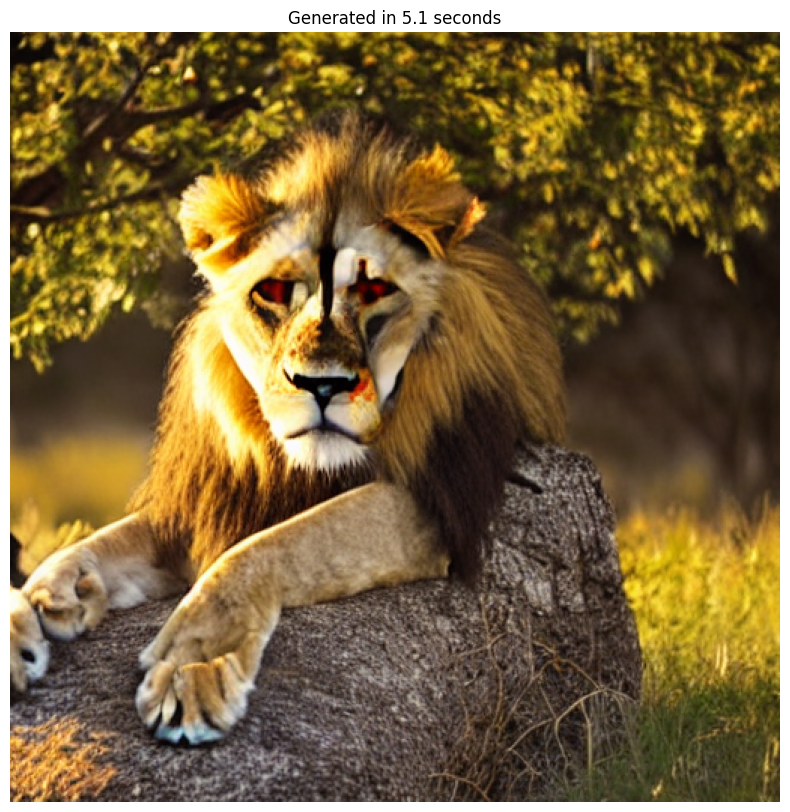

Run this cell again to generate another image.


In [19]:

print("\n GENERATE IMAGE with Stable diffusion model")
print("=" * 60)


user_prompt = input("Enter your prompt: ")

if user_prompt.strip():
    print(f"\n📸 Generating: {user_prompt}")
    print("   Please wait...")

    start_time = datetime.now()

  # inference_mode() disables gradient calculation for faster inference
    with torch.inference_mode():
        result = pipe(
            prompt=user_prompt,
            num_inference_steps=25,
            guidance_scale=7.5,
            height=512,
            width=512
        )
   # Calculate how long generation took
    gen_time = (datetime.now() - start_time).total_seconds()

    # Display the generated image
    plt.figure(figsize=(10, 10))
    plt.imshow(result.images[0])
    plt.title(f"Generated in {gen_time:.1f} seconds", fontsize=12)
    plt.axis('off')
    plt.show()

    print(f"Run this cell again to generate another image.")
else:
    print(" No prompt entered. Please run the cell again.")

---
# 6. MODEL FINE-TUNING
---
Fine-tune Stable Diffusion UNet on domain-specific data

In [20]:

print("\n CLEARING ALL UNNECESSARY MEMORY")
print("=" * 60)

import torch
import gc
import os


# List of variables from previous cells that we no longer need
vars_to_delete = ['text_model', 'model', 'embeddings', 'generated_images',
                  'all_embeddings', 'metadata', 'pairs', 'caption_data']

for var in vars_to_delete:
    if var in globals():
        del globals()[var]
        print(f"   Deleted {var}")

torch.cuda.empty_cache()
gc.collect()

print(f"  GPU Memory: {torch.cuda.memory_allocated()/1024**3:.2f} GB")

print("=" * 60)


if pipe.unet.dtype != torch.float16:

    # Convert each component to float16 (half precision)
    pipe.unet = pipe.unet.half()   # Main denoising network
    pipe.vae = pipe.vae.half()     # Variational Autoencoder (image encoder/decoder)
    pipe.text_encoder = pipe.text_encoder.half()  # Text encoder (processes prompts)

unet = pipe.unet
vae = pipe.vae
text_encoder = pipe.text_encoder
tokenizer = pipe.tokenizer
trainable_params = []
param_names = []


# Iterate through all UNet parameters
for name, param in unet.named_parameters():

    if "attn2" in name and "to_v" in name:
        param.requires_grad = True
        trainable_params.append(param)
        param_names.append(name)
    else:
        param.requires_grad = False

# Display training statistics
print(f"   Training only {len(trainable_params)} parameters")
print(f"   Total trainable: {sum(p.numel() for p in trainable_params)/1e6:.2f}M")
print(f"   Frozen: {sum(p.numel() for p in unet.parameters() if not p.requires_grad)/1e6:.2f}M")


print("\n  Training layers:")
for name in param_names[:5]:
    print(f"    - {name}")
if len(param_names) > 5:
    print(f"    ... and {len(param_names)-5} more")


unet.train()
vae.eval()
text_encoder.eval()


unet.enable_gradient_checkpointing()


# Configure optimizer for parameter updates during training
print("\n CREATING OPTIMIZER")
print("=" * 60)

import torch.optim as optim
from diffusers import DDPMScheduler
import torch.nn.functional as F


optimizer = optim.SGD(
    trainable_params,
    lr=1e-5,
    momentum=0.9
)

# Use SGD (Stochastic Gradient Descent)
print(f"   Using SGD optimizer (memory efficient)")
print(f"   Optimizing {len(trainable_params)} parameters only")

noise_scheduler = DDPMScheduler.from_config(pipe.scheduler.config)

torch.cuda.empty_cache()
print(f"  GPU Memory: {torch.cuda.memory_allocated()/1024**3:.2f} GB")


# Prepare animal images for training
print("\n CREATING ANIMAL DATASET")
print("=" * 60)

from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import random

class AnimalDataset(Dataset):
    def __init__(self, pairs, tokenizer, size=256, max_samples=2000):

        random.seed(42)
        self.pairs = random.sample(pairs, min(max_samples, len(pairs)))
        self.tokenizer = tokenizer

       # Define image transformations
        self.transforms = transforms.Compose([
            transforms.Resize((size, size)),
            transforms.ToTensor(),
            transforms.Normalize([0.5], [0.5])
        ])

    def __len__(self):
        return len(self.pairs)

    def __getitem__(self, idx):
        pair = self.pairs[idx]
        image = Image.open(pair["image_path"]).convert("RGB")
        image = self.transforms(image)

       # Tokenize caption (convert text to numbers)
        text_inputs = self.tokenizer(
            pair["caption"],
            max_length=77,
            padding="max_length",
            truncation=True,
            return_tensors="pt"
        )

        return {
            "pixel_values": image,
            "input_ids": text_inputs.input_ids[0]
        }

# Create dataset and dataloader
train_dataset = AnimalDataset(subset_clean, tokenizer, 256, max_samples=2000)
train_dataloader = DataLoader(train_dataset, batch_size=1, shuffle=True)

print(f"  Training on {len(train_dataset)} animal images (50% of our 4000)")
print(f"  This gives us excellent coverage of the animal domain!")


# TRAINING LOOP
print("\n STARTING TRAINING ON ANIMAL DATASET")
print("=" * 60)
print("  Training the  attention layers to save memory")
print("  Using a large portion of our animal dataset!")

import numpy as np
from datetime import datetime

losses = []

# Training hyperparameters
NUM_EPOCHS = 2
MAX_STEPS = len(train_dataset) * NUM_EPOCHS
CHECKPOINT_EVERY = 100

print(f"  Will train for {NUM_EPOCHS} epochs")
print(f"  Total steps: {MAX_STEPS} (seeing each image {NUM_EPOCHS} times)")
print(f"  This uses ALL {len(train_dataset)} images multiple times!\n")

start_time = datetime.now()
global_step = 0

for epoch in range(NUM_EPOCHS):
    print(f"\n EPOCH {epoch + 1}/{NUM_EPOCHS}")
    print("-" * 40)

    epoch_losses = []

    for step, batch in enumerate(train_dataloader):
        if global_step >= MAX_STEPS:
            break


        if global_step % 10 == 0:
            torch.cuda.empty_cache()


        pixel_values = batch["pixel_values"].to(DEVICE, dtype=torch.float16)
        input_ids = batch["input_ids"].to(DEVICE)

        try:

            # FORWARD PASS
            with torch.no_grad():

                # Encode image to latent space
                latents = vae.encode(pixel_values).latent_dist.sample()
                latents = latents * vae.config.scaling_factor
                encoder_hidden_states = text_encoder(input_ids)[0]


            with torch.amp.autocast('cuda', dtype=torch.float16):
                noise = torch.randn_like(latents)
                timesteps = torch.randint(0, 1000, (1,), device=DEVICE).long()
                noisy_latents = noise_scheduler.add_noise(latents, noise, timesteps)


                noise_pred = unet(
                    noisy_latents,
                    timesteps,
                    encoder_hidden_states=encoder_hidden_states
                ).sample


                loss = F.mse_loss(noise_pred.float(), noise.float())


            if torch.isnan(loss):
                print(f"  Step {global_step}: NaN - skipping")
                optimizer.zero_grad()
                continue

            # BACKWARD PASS & OPTIMIZATION
            loss.backward()
            torch.nn.utils.clip_grad_norm_(trainable_params, max_norm=1.0)
            optimizer.step()
            optimizer.zero_grad()

            losses.append(loss.item())
            epoch_losses.append(loss.item())


            if global_step % 50 == 0:
                mem = torch.cuda.memory_allocated()/1024**3
                elapsed = (datetime.now() - start_time).total_seconds()
                imgs_per_sec = (global_step + 1) / elapsed if elapsed > 0 else 0
                print(f"  Step {global_step:4d}: Loss = {loss.item():.4f} | Mem = {mem:.1f} GB | {imgs_per_sec:.1f} imgs/sec")


            if global_step % CHECKPOINT_EVERY == 0 and global_step > 0:
                avg_loss = np.mean(losses[-100:]) if len(losses) >= 100 else np.mean(losses)
                print(f"   Checkpoint: Avg loss = {avg_loss:.4f} | Processed {global_step}/{MAX_STEPS} steps")

            global_step += 1

        except RuntimeError as e:
            if "out of memory" in str(e):
                print(f"  Step {global_step}: OOM - clearing cache")
                optimizer.zero_grad()
                torch.cuda.empty_cache()
                continue
            else:
                raise e


    if epoch_losses:
        epoch_avg = np.mean(epoch_losses)
        print(f"\n   Epoch {epoch+1} complete: Avg loss = {epoch_avg:.4f}")

elapsed_total = (datetime.now() - start_time).total_seconds()
print(f"\n Training complete!")
print(f"  Total steps: {global_step}")
print(f"  Images seen: {global_step} (each image seen {NUM_EPOCHS} times)")
print(f"  Time: {elapsed_total:.1f} seconds ({elapsed_total/60:.1f} minutes)")
print(f"  Avg loss: {np.mean(losses):.4f}" if losses else "N/A")


print("\n CLEANUP")
print("=" * 60)


for param in unet.parameters():
    param.requires_grad = True

unet.eval()
del optimizer
torch.cuda.empty_cache()
gc.collect()

print(f"  Final GPU Memory: {torch.cuda.memory_allocated()/1024**3:.2f} GB")




 CLEARING ALL UNNECESSARY MEMORY
   Deleted text_model
   Deleted embeddings
   Deleted generated_images
   Deleted all_embeddings
   Deleted metadata
   Deleted pairs
   Deleted caption_data
  GPU Memory: 2.02 GB
   Training only 16 parameters
   Total trainable: 9.58M
   Frozen: 849.94M

  Training layers:
    - down_blocks.0.attentions.0.transformer_blocks.0.attn2.to_v.weight
    - down_blocks.0.attentions.1.transformer_blocks.0.attn2.to_v.weight
    - down_blocks.1.attentions.0.transformer_blocks.0.attn2.to_v.weight
    - down_blocks.1.attentions.1.transformer_blocks.0.attn2.to_v.weight
    - down_blocks.2.attentions.0.transformer_blocks.0.attn2.to_v.weight
    ... and 11 more

 CREATING OPTIMIZER
   Using SGD optimizer (memory efficient)
   Optimizing 16 parameters only
  GPU Memory: 2.02 GB

 CREATING ANIMAL DATASET
  Training on 2000 animal images (50% of our 4000)
  This gives us excellent coverage of the animal domain!

 STARTING TRAINING ON ANIMAL DATASET
  Training the  att

In [21]:
# ============================================================
# SAVE FINE-TUNED MODEL
# ============================================================

print("\n SAVING FINE-TUNED MODEL")
print("=" * 60)

model_save_path = "models/fine_tuned_animals"
os.makedirs(model_save_path, exist_ok=True)

print("  Saving fine-tuned pipeline...")
try:

    pipe.save_pretrained(model_save_path)
    print(f"   Complete pipeline saved to: {model_save_path}")


    unet_path = os.path.join(model_save_path, "unet_finetuned")
    pipe.unet.save_pretrained(unet_path)
    print(f"   Fine-tuned UNet saved to: {unet_path}")

     # Record training details for reproducibility and documentation
    training_info = {
        "domain": "animals",
        "training_samples": len(train_dataset),
        "total_steps": global_step,
        "epochs": NUM_EPOCHS,
        "final_loss": float(np.mean(losses[-10:])) if losses else None,
        "training_time_seconds": elapsed_total,
        "date": datetime.now().isoformat()
    }

    # Save metadata as JSON file
    import json
    with open(os.path.join(model_save_path, "training_info.json"), "w") as f:
        json.dump(training_info, f, indent=2)
    print(f"   Training info saved")

except Exception as e:
    print(f"   Error saving model: {e}")
    print("  WARNING: Model not saved")

print("=" * 60)


 SAVING FINE-TUNED MODEL
  Saving fine-tuned pipeline...
   Complete pipeline saved to: models/fine_tuned_animals
   Fine-tuned UNet saved to: models/fine_tuned_animals/unet_finetuned
   Training info saved



 GENERATING IMAGES WITH FINE-TUNED MODEL
  Generating: A majestic lion in the savanna


  0%|          | 0/20 [00:00<?, ?it/s]

     Saved as animal_1.png
  Generating: A playful puppy in a garden


  0%|          | 0/20 [00:00<?, ?it/s]

     Saved as animal_2.png
  Generating: A colorful parrot on a tree branch


  0%|          | 0/20 [00:00<?, ?it/s]

     Saved as animal_3.png

   Generated 3 test images


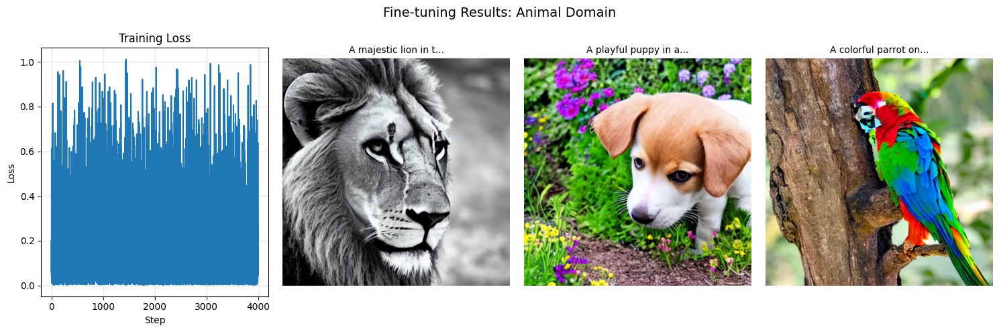


 ANIMAL FINE-TUNING COMPLETE!
  • Trained on 2000 of our 4000 animal images
  • Only trained attention layers (memory efficient)
  • Model is now better at understanding animal-related prompts

 For even better results, consider:
  • Training for more steps (increase MAX_STEPS)
  • Using LoRA for more efficient fine-tuning
  • Training on a cloud GPU with more memory


In [22]:
# GENERATE TEST IMAGES WITH FINE-TUNED MODEL
print("\n GENERATING IMAGES WITH FINE-TUNED MODEL")
print("=" * 60)

# Define test prompts to evaluate model performance
test_prompts = [
    "A majestic lion in the savanna",
    "A playful puppy in a garden",
    "A colorful parrot on a tree branch"
]

os.makedirs("data/finetuned_animals", exist_ok=True)
test_images = []

# Generate an image for each test prompt
for i, prompt in enumerate(test_prompts):
    print(f"  Generating: {prompt}")

    # Use automatic mixed precision for memory efficiency
    with torch.inference_mode():
        with torch.amp.autocast('cuda', dtype=torch.float16):
            image = pipe(
                prompt,
                num_inference_steps=20,
                guidance_scale=7.5,
                height=512,
                width=512
            ).images[0]

    # Save the generated image to disk
    filename = f"animal_{i+1}.png"
    image.save(f"data/finetuned_animals/{filename}")
    test_images.append(image)
    print(f"     Saved as {filename}")

print(f"\n   Generated {len(test_images)} test images")


if test_images and losses:
    import matplotlib.pyplot as plt

    fig = plt.figure(figsize=(15, 5))


    ax1 = plt.subplot(1, 4, 1)
    ax1.plot(losses)
    ax1.set_title("Training Loss")
    ax1.set_xlabel("Step")
    ax1.set_ylabel("Loss")
    ax1.grid(True, alpha=0.3)


    for i, (img, prompt) in enumerate(zip(test_images[:3], test_prompts[:3])):
        ax = plt.subplot(1, 4, i+2)
        ax.imshow(img)
        ax.set_title(prompt[:20] + "...", fontsize=10)
        ax.axis('off')

    plt.suptitle("Fine-tuning Results: Animal Domain", fontsize=14)
    plt.tight_layout()
    plt.savefig("data/finetuned_animals/training_summary.png")
    plt.show()

print("\n" + "="*60)
print(" ANIMAL FINE-TUNING COMPLETE!")
print(f"  • Trained on {min(MAX_STEPS, len(train_dataset))} of our {len(subset_clean)} animal images")
print(f"  • Only trained attention layers (memory efficient)")
print(f"  • Model is now better at understanding animal-related prompts")
print("\n For even better results, consider:")
print("  • Training for more steps (increase MAX_STEPS)")
print("  • Using LoRA for more efficient fine-tuning")
print("  • Training on a cloud GPU with more memory")
print("="*60)


 GENERATE WITH YOUR FINE-TUNED MODEL
Model specialized for particular domain
--------------------------------------------------------------------------------
Enter your prompt: dog playing in garden

 Generating with fine-tuned model: dog playing in garden
   Please wait...


  0%|          | 0/25 [00:00<?, ?it/s]

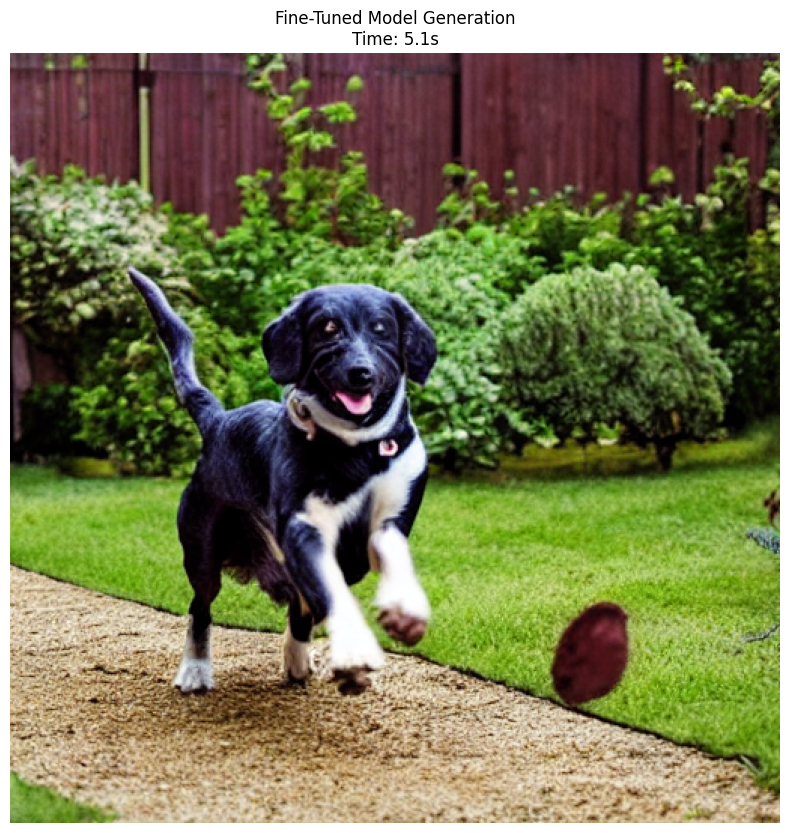

 Generated in 5.1 seconds

 Tip: This model is fine-tuned for a particular domain
Run this cell again to generate another image.


In [23]:

# FINE-TUNED STABLE DIFFUSION IMAGE GENERATION
print("\n" + "="*80)
print(" GENERATE WITH YOUR FINE-TUNED MODEL")
print("="*80)
print("Model specialized for particular domain")
print("-" * 80)

user_prompt = input("Enter your prompt: ")

if user_prompt.strip():
    print(f"\n Generating with fine-tuned model: {user_prompt}")
    print("   Please wait...")

    start_time = datetime.now()


    with torch.inference_mode():
        result = pipe(
            prompt=user_prompt,
            num_inference_steps=25,
            guidance_scale=7.5,
            height=512,
            width=512
        )

    gen_time = (datetime.now() - start_time).total_seconds()


    plt.figure(figsize=(10, 10))
    plt.imshow(result.images[0])
    plt.title(f"Fine-Tuned Model Generation\nTime: {gen_time:.1f}s", fontsize=12)
    plt.axis('off')
    plt.show()

    print(f" Generated in {gen_time:.1f} seconds")
    print("\n Tip: This model is fine-tuned for a particular domain")
    print("Run this cell again to generate another image.")
else:
    print(" No prompt entered. Please run the cell again.")

****Experiment with different CFGs and Schedulers and choosing the best model****

In [24]:


import torch
import numpy as np
import os
from datetime import datetime
from PIL import Image
import pandas as pd
import matplotlib.pyplot as plt
from torchvision import models, transforms
from scipy import linalg
import json
from tqdm import tqdm

from diffusers import (
    StableDiffusionPipeline,
    DDIMScheduler,
    PNDMScheduler,
    DPMSolverMultistepScheduler,
    EulerDiscreteScheduler
)

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {DEVICE}")

Using device: cuda


In [25]:

MODEL_PATH = "models/fine_tuned_animals"


CFG_SCALES = [5.0, 7.5, 10]
SCHEDULERS = {
    "DDIM": DDIMScheduler,
    "PNDM": PNDMScheduler,
    "Euler": EulerDiscreteScheduler
}

CAT_PROMPT = "A photorealistic orange tabby cat sitting gracefully, highly detailed"
NUM_STEPS = 40
NUM_TEST_IMAGES = 40

print("\n" + "="*80)
print("CONFIGURATION READY")
print("="*80)
print(f"Schedulers to test: {list(SCHEDULERS.keys())}")
print(f"CFG scales to test: {CFG_SCALES}")
print(f"Steps: {NUM_STEPS}")
print(f"Images per config: {NUM_TEST_IMAGES}")


CONFIGURATION READY
Schedulers to test: ['DDIM', 'PNDM', 'Euler']
CFG scales to test: [5.0, 7.5, 10]
Steps: 40
Images per config: 40


In [26]:

print("\nLoading fine-tuned model...")
pipe = StableDiffusionPipeline.from_pretrained(
    MODEL_PATH,
    torch_dtype=torch.float16 if torch.cuda.is_available() else torch.float32,
    safety_checker=None,
    requires_safety_checker=False
).to(DEVICE)

if hasattr(pipe, "enable_attention_slicing"):
    pipe.enable_attention_slicing()

print(f" Model loaded from: {MODEL_PATH}")


Loading fine-tuned model...


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

 Model loaded from: models/fine_tuned_animals


In [27]:
# EVALUATION METRICS FOR STABLE DIFFUSION - FID & INCEPTION SCORE

print("Setting up InceptionV3 for proper metrics...")

# INCEPTION V3 MODEL SETUP - Feature Extractor
inception_model = models.inception_v3(pretrained=True, transform_input=False)
inception_model.eval()
inception_model.to(DEVICE)


preprocess = transforms.Compose([
    transforms.Resize((299, 299), Image.BILINEAR),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# FEATURE EXTRACTION FUNCTION
def get_inception_features(images):
    """Extract proper 2048-dim features from InceptionV3"""
    features = []


    inception_model.fc = torch.nn.Identity()

    with torch.no_grad():
        for img in images:
            img_tensor = preprocess(img).unsqueeze(0).to(DEVICE)
            feat = inception_model(img_tensor)
            features.append(feat.cpu().numpy())

    return np.vstack(features)


# FID (FRÉCHET INCEPTION DISTANCE) CALCULATION
def calculate_proper_fid(features1, features2):
    """Calculate proper FID score using Fréchet distance"""

    mu1, sigma1 = np.mean(features1, axis=0), np.cov(features1, rowvar=False)
    mu2, sigma2 = np.mean(features2, axis=0), np.cov(features2, rowvar=False)


    diff = mu1 - mu2


    covmean, _ = linalg.sqrtm(sigma1.dot(sigma2), disp=False)


    if np.iscomplexobj(covmean):
        covmean = covmean.real


    tr_covmean = np.trace(covmean)
    fid = diff.dot(diff) + np.trace(sigma1) + np.trace(sigma2) - 2 * tr_covmean

    return float(fid)

# INCEPTION SCORE (IS) CALCULATION
def calculate_proper_is(images, splits=5):
    """Calculate proper Inception Score"""

    inception_model.fc = torch.nn.Linear(2048, 1000).to(DEVICE)
    inception_model.eval()

    preds = []
    with torch.no_grad():
        for img in images:
            img_tensor = preprocess(img).unsqueeze(0).to(DEVICE)
            logits = inception_model(img_tensor)
            pred = torch.nn.functional.softmax(logits, dim=1)
            preds.append(pred.cpu().numpy())

    preds = np.vstack(preds)


    scores = []
    split_size = len(preds) // splits

    for i in range(splits):
        part = preds[i * split_size : (i + 1) * split_size]
        py = np.mean(part, axis=0)

        kl_scores = []
        for px in part:
            kl = np.sum(px * (np.log(px + 1e-10) - np.log(py + 1e-10)))
            kl_scores.append(kl)

        scores.append(np.exp(np.mean(kl_scores)))

    return float(np.mean(scores)), float(np.std(scores))

print(" Proper metrics functions ready")

Setting up InceptionV3 for proper metrics...
Downloading: "https://download.pytorch.org/models/inception_v3_google-0cc3c7bd.pth" to /root/.cache/torch/hub/checkpoints/inception_v3_google-0cc3c7bd.pth


/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
100%|██████████| 104M/104M [00:00<00:00, 192MB/s] 


 Proper metrics functions ready


In [28]:
# REFERENCE IMAGE GENERATION FOR FID BASELINE
print("\n" + "="*80)
print("GENERATING REFERENCE SET")
print("="*80)


reference_prompts = [
    "A fluffy white cat sitting elegantly",
    "A sleek black cat with yellow eyes",
    "A playful kitten with a toy",
    "A majestic cat with long fur",
    "A cute cat with striking blue eyes"
]

pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)

print("Generating reference images for FID baseline...")
reference_images = []

for i in tqdm(range(NUM_TEST_IMAGES), desc="Reference images"):
    prompt = reference_prompts[i % len(reference_prompts)]

    with torch.inference_mode():
        img = pipe(
            prompt=prompt,
            num_inference_steps=NUM_STEPS,
            guidance_scale=7.5,
            height=512,
            width=512,
            generator=torch.Generator(DEVICE).manual_seed(i * 100)
        ).images[0]

    reference_images.append(img)
print("Extracting reference features...")
reference_features = get_inception_features(reference_images)
print(f" Reference features shape: {reference_features.shape}")


GENERATING REFERENCE SET
Generating reference images for FID baseline...


Reference images:   0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:   2%|▎         | 1/40 [00:07<05:02,  7.75s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:   5%|▌         | 2/40 [00:15<04:53,  7.73s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:   8%|▊         | 3/40 [00:23<04:46,  7.75s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  10%|█         | 4/40 [00:31<04:40,  7.78s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  12%|█▎        | 5/40 [00:38<04:33,  7.81s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  15%|█▌        | 6/40 [00:46<04:26,  7.84s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  18%|█▊        | 7/40 [00:54<04:19,  7.86s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  20%|██        | 8/40 [01:02<04:12,  7.88s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  22%|██▎       | 9/40 [01:10<04:05,  7.92s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  25%|██▌       | 10/40 [01:18<03:58,  7.95s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  28%|██▊       | 11/40 [01:26<03:51,  7.98s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  30%|███       | 12/40 [01:34<03:44,  8.01s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  32%|███▎      | 13/40 [01:42<03:37,  8.05s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  35%|███▌      | 14/40 [01:51<03:30,  8.10s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  38%|███▊      | 15/40 [01:59<03:23,  8.13s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  40%|████      | 16/40 [02:07<03:15,  8.16s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  42%|████▎     | 17/40 [02:15<03:08,  8.18s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  45%|████▌     | 18/40 [02:24<03:00,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  48%|████▊     | 19/40 [02:32<02:52,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  50%|█████     | 20/40 [02:40<02:43,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  52%|█████▎    | 21/40 [02:48<02:35,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  55%|█████▌    | 22/40 [02:56<02:27,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  57%|█████▊    | 23/40 [03:04<02:19,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  60%|██████    | 24/40 [03:13<02:10,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  62%|██████▎   | 25/40 [03:21<02:02,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  65%|██████▌   | 26/40 [03:29<01:54,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  68%|██████▊   | 27/40 [03:37<01:46,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  70%|███████   | 28/40 [03:45<01:38,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  72%|███████▎  | 29/40 [03:54<01:30,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  75%|███████▌  | 30/40 [04:02<01:22,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  78%|███████▊  | 31/40 [04:10<01:13,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  80%|████████  | 32/40 [04:18<01:05,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  82%|████████▎ | 33/40 [04:26<00:57,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  85%|████████▌ | 34/40 [04:35<00:49,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  88%|████████▊ | 35/40 [04:43<00:41,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  90%|█████████ | 36/40 [04:51<00:32,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  92%|█████████▎| 37/40 [04:59<00:24,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  95%|█████████▌| 38/40 [05:07<00:16,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images:  98%|█████████▊| 39/40 [05:16<00:08,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Reference images: 100%|██████████| 40/40 [05:24<00:00,  8.11s/it]


Extracting reference features...
 Reference features shape: (40, 2048)


In [29]:
# Testing all Configurations
print("\n" + "="*80)
print("TESTING ALL CONFIGURATIONS")
print("="*80)

results = []
cat_images = {}

for scheduler_name, scheduler_class in SCHEDULERS.items():
    print(f"\n🔧 Scheduler: {scheduler_name}")
    pipe.scheduler = scheduler_class.from_config(pipe.scheduler.config)

    for cfg in CFG_SCALES:
        config_name = f"{scheduler_name}_cfg{cfg}"
        print(f"  Testing CFG={cfg}")


        generated_images = []
        generation_times = []

        for i in tqdm(range(NUM_TEST_IMAGES), desc=f"    Generating", leave=False):
            start = datetime.now()

            with torch.inference_mode():
                img = pipe(
                    prompt=CAT_PROMPT,  # SAME PROMPT FOR ALL
                    num_inference_steps=NUM_STEPS,
                    guidance_scale=cfg,
                    height=512,
                    width=512,
                    generator=torch.Generator(DEVICE).manual_seed(i)
                ).images[0]

            generation_times.append((datetime.now() - start).total_seconds())
            generated_images.append(img)


            if i == 0:
                cat_images[config_name] = img


        print("    Calculating metrics...")


        gen_features = get_inception_features(generated_images)
        fid = calculate_proper_fid(reference_features, gen_features)


        is_mean, is_std = calculate_proper_is(generated_images)

        avg_time = np.mean(generation_times)

        results.append({
            "scheduler": scheduler_name,
            "cfg": cfg,
            "fid": fid,
            "is": is_mean,
            "is_std": is_std,
            "time": avg_time
        })

        print(f"     FID: {fid:.2f} | IS: {is_mean:.2f}±{is_std:.2f} | Time: {avg_time:.2f}s")


        if torch.cuda.is_available():
            torch.cuda.empty_cache()

print("\n All configurations tested!")



TESTING ALL CONFIGURATIONS

🔧 Scheduler: DDIM
  Testing CFG=5.0


    Generating:   0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   2%|▎         | 1/40 [00:08<05:23,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   5%|▌         | 2/40 [00:16<05:15,  8.31s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   8%|▊         | 3/40 [00:24<05:06,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  10%|█         | 4/40 [00:33<04:58,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  12%|█▎        | 5/40 [00:41<04:50,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  15%|█▌        | 6/40 [00:49<04:42,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  18%|█▊        | 7/40 [00:58<04:33,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  20%|██        | 8/40 [01:06<04:25,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  22%|██▎       | 9/40 [01:14<04:17,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  25%|██▌       | 10/40 [01:22<04:09,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  28%|██▊       | 11/40 [01:31<04:00,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  30%|███       | 12/40 [01:39<03:52,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  32%|███▎      | 13/40 [01:47<03:44,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  35%|███▌      | 14/40 [01:56<03:35,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  38%|███▊      | 15/40 [02:04<03:27,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  40%|████      | 16/40 [02:12<03:19,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  42%|████▎     | 17/40 [02:21<03:10,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  45%|████▌     | 18/40 [02:29<03:02,  8.29s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  48%|████▊     | 19/40 [02:37<02:54,  8.29s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  50%|█████     | 20/40 [02:45<02:45,  8.29s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  52%|█████▎    | 21/40 [02:54<02:37,  8.29s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  55%|█████▌    | 22/40 [03:02<02:29,  8.29s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  57%|█████▊    | 23/40 [03:10<02:20,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  60%|██████    | 24/40 [03:19<02:12,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  62%|██████▎   | 25/40 [03:27<02:04,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  65%|██████▌   | 26/40 [03:35<01:55,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  68%|██████▊   | 27/40 [03:43<01:47,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  70%|███████   | 28/40 [03:52<01:39,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  72%|███████▎  | 29/40 [04:00<01:30,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  75%|███████▌  | 30/40 [04:08<01:22,  8.26s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  78%|███████▊  | 31/40 [04:16<01:14,  8.26s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  80%|████████  | 32/40 [04:25<01:06,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  82%|████████▎ | 33/40 [04:33<00:57,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  85%|████████▌ | 34/40 [04:41<00:49,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  88%|████████▊ | 35/40 [04:49<00:41,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  90%|█████████ | 36/40 [04:58<00:33,  8.26s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  92%|█████████▎| 37/40 [05:06<00:24,  8.26s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  95%|█████████▌| 38/40 [05:14<00:16,  8.26s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  98%|█████████▊| 39/40 [05:23<00:08,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Calculating metrics...


/tmp/ipython-input-1828971535.py:45: DeprecationWarning: The `disp` argument is deprecated and will be removed in SciPy 1.18.0.
  covmean, _ = linalg.sqrtm(sigma1.dot(sigma2), disp=False)


     FID: 159.44 | IS: 1.00±0.00 | Time: 8.28s
  Testing CFG=7.5


    Generating:   0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   2%|▎         | 1/40 [00:08<05:19,  8.18s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   5%|▌         | 2/40 [00:16<05:13,  8.26s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   8%|▊         | 3/40 [00:24<05:07,  8.32s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  10%|█         | 4/40 [00:33<05:02,  8.39s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  12%|█▎        | 5/40 [00:41<04:54,  8.42s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  15%|█▌        | 6/40 [00:50<04:45,  8.39s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  18%|█▊        | 7/40 [00:58<04:35,  8.35s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  20%|██        | 8/40 [01:06<04:26,  8.32s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  22%|██▎       | 9/40 [01:14<04:16,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  25%|██▌       | 10/40 [01:23<04:07,  8.25s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  28%|██▊       | 11/40 [01:31<03:58,  8.24s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  30%|███       | 12/40 [01:39<03:50,  8.24s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  32%|███▎      | 13/40 [01:47<03:42,  8.26s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  35%|███▌      | 14/40 [01:56<03:35,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  38%|███▊      | 15/40 [02:04<03:27,  8.29s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  40%|████      | 16/40 [02:12<03:19,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  42%|████▎     | 17/40 [02:21<03:10,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  45%|████▌     | 18/40 [02:29<03:02,  8.29s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  48%|████▊     | 19/40 [02:37<02:53,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  50%|█████     | 20/40 [02:45<02:45,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  52%|█████▎    | 21/40 [02:54<02:37,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  55%|█████▌    | 22/40 [03:02<02:28,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  57%|█████▊    | 23/40 [03:10<02:20,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  60%|██████    | 24/40 [03:18<02:12,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  62%|██████▎   | 25/40 [03:27<02:04,  8.29s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  65%|██████▌   | 26/40 [03:35<01:56,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  68%|██████▊   | 27/40 [03:43<01:47,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  70%|███████   | 28/40 [03:52<01:39,  8.29s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  72%|███████▎  | 29/40 [04:00<01:31,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  75%|███████▌  | 30/40 [04:08<01:22,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  78%|███████▊  | 31/40 [04:16<01:14,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  80%|████████  | 32/40 [04:25<01:06,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  82%|████████▎ | 33/40 [04:33<00:57,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  85%|████████▌ | 34/40 [04:41<00:49,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  88%|████████▊ | 35/40 [04:50<00:41,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  90%|█████████ | 36/40 [04:58<00:33,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  92%|█████████▎| 37/40 [05:06<00:24,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  95%|█████████▌| 38/40 [05:14<00:16,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  98%|█████████▊| 39/40 [05:23<00:08,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Calculating metrics...
     FID: 154.26 | IS: 1.00±0.00 | Time: 8.29s
  Testing CFG=10


    Generating:   0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   2%|▎         | 1/40 [00:08<05:18,  8.18s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   5%|▌         | 2/40 [00:16<05:13,  8.25s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   8%|▊         | 3/40 [00:24<05:08,  8.33s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  10%|█         | 4/40 [00:33<05:02,  8.40s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  12%|█▎        | 5/40 [00:41<04:54,  8.42s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  15%|█▌        | 6/40 [00:50<04:45,  8.39s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  18%|█▊        | 7/40 [00:58<04:35,  8.35s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  20%|██        | 8/40 [01:06<04:25,  8.31s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  22%|██▎       | 9/40 [01:14<04:16,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  25%|██▌       | 10/40 [01:23<04:07,  8.24s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  28%|██▊       | 11/40 [01:31<03:58,  8.23s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  30%|███       | 12/40 [01:39<03:50,  8.24s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  32%|███▎      | 13/40 [01:47<03:42,  8.26s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  35%|███▌      | 14/40 [01:56<03:35,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  38%|███▊      | 15/40 [02:04<03:27,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  40%|████      | 16/40 [02:12<03:19,  8.31s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  42%|████▎     | 17/40 [02:21<03:11,  8.31s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  45%|████▌     | 18/40 [02:29<03:02,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  48%|████▊     | 19/40 [02:37<02:54,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  50%|█████     | 20/40 [02:45<02:45,  8.29s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  52%|█████▎    | 21/40 [02:54<02:37,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  55%|█████▌    | 22/40 [03:02<02:28,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  57%|█████▊    | 23/40 [03:10<02:20,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  60%|██████    | 24/40 [03:19<02:12,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  62%|██████▎   | 25/40 [03:27<02:04,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  65%|██████▌   | 26/40 [03:35<01:55,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  68%|██████▊   | 27/40 [03:43<01:47,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  70%|███████   | 28/40 [03:52<01:39,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  72%|███████▎  | 29/40 [04:00<01:31,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  75%|███████▌  | 30/40 [04:08<01:22,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  78%|███████▊  | 31/40 [04:16<01:14,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  80%|████████  | 32/40 [04:25<01:06,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  82%|████████▎ | 33/40 [04:33<00:57,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  85%|████████▌ | 34/40 [04:41<00:49,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  88%|████████▊ | 35/40 [04:50<00:41,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  90%|█████████ | 36/40 [04:58<00:33,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  92%|█████████▎| 37/40 [05:06<00:24,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  95%|█████████▌| 38/40 [05:14<00:16,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  98%|█████████▊| 39/40 [05:23<00:08,  8.28s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Calculating metrics...
     FID: 150.91 | IS: 1.00±0.00 | Time: 8.29s

🔧 Scheduler: PNDM
  Testing CFG=5.0


    Generating:   0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   2%|▎         | 1/40 [00:08<05:27,  8.40s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   5%|▌         | 2/40 [00:16<05:21,  8.47s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   8%|▊         | 3/40 [00:25<05:15,  8.54s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  10%|█         | 4/40 [00:34<05:10,  8.61s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  12%|█▎        | 5/40 [00:42<05:01,  8.61s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  15%|█▌        | 6/40 [00:51<04:51,  8.58s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  18%|█▊        | 7/40 [00:59<04:41,  8.54s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  20%|██        | 8/40 [01:08<04:31,  8.49s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  22%|██▎       | 9/40 [01:16<04:22,  8.45s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  25%|██▌       | 10/40 [01:25<04:13,  8.44s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  28%|██▊       | 11/40 [01:33<04:04,  8.43s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  30%|███       | 12/40 [01:41<03:56,  8.44s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  32%|███▎      | 13/40 [01:50<03:48,  8.46s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  35%|███▌      | 14/40 [01:58<03:40,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  38%|███▊      | 15/40 [02:07<03:32,  8.50s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  40%|████      | 16/40 [02:15<03:24,  8.51s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  42%|████▎     | 17/40 [02:24<03:15,  8.51s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  45%|████▌     | 18/40 [02:32<03:06,  8.50s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  48%|████▊     | 19/40 [02:41<02:58,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  50%|█████     | 20/40 [02:49<02:49,  8.47s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  52%|█████▎    | 21/40 [02:58<02:40,  8.46s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  55%|█████▌    | 22/40 [03:06<02:32,  8.46s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  57%|█████▊    | 23/40 [03:15<02:23,  8.46s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  60%|██████    | 24/40 [03:23<02:15,  8.46s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  62%|██████▎   | 25/40 [03:32<02:06,  8.47s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  65%|██████▌   | 26/40 [03:40<01:58,  8.47s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  68%|██████▊   | 27/40 [03:49<01:50,  8.47s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  70%|███████   | 28/40 [03:57<01:41,  8.47s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  72%|███████▎  | 29/40 [04:06<01:33,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  75%|███████▌  | 30/40 [04:14<01:24,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  78%|███████▊  | 31/40 [04:23<01:16,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  80%|████████  | 32/40 [04:31<01:07,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  82%|████████▎ | 33/40 [04:39<00:59,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  85%|████████▌ | 34/40 [04:48<00:50,  8.47s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  88%|████████▊ | 35/40 [04:56<00:42,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  90%|█████████ | 36/40 [05:05<00:33,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  92%|█████████▎| 37/40 [05:13<00:25,  8.49s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  95%|█████████▌| 38/40 [05:22<00:16,  8.49s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  98%|█████████▊| 39/40 [05:30<00:08,  8.49s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Calculating metrics...
     FID: 156.84 | IS: 1.00±0.00 | Time: 8.48s
  Testing CFG=7.5


    Generating:   0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   2%|▎         | 1/40 [00:08<05:26,  8.38s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   5%|▌         | 2/40 [00:16<05:21,  8.46s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   8%|▊         | 3/40 [00:25<05:16,  8.55s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  10%|█         | 4/40 [00:34<05:10,  8.62s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  12%|█▎        | 5/40 [00:42<05:01,  8.62s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  15%|█▌        | 6/40 [00:51<04:51,  8.58s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  18%|█▊        | 7/40 [00:59<04:41,  8.54s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  20%|██        | 8/40 [01:08<04:31,  8.49s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  22%|██▎       | 9/40 [01:16<04:22,  8.45s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  25%|██▌       | 10/40 [01:24<04:12,  8.43s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  28%|██▊       | 11/40 [01:33<04:04,  8.43s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  30%|███       | 12/40 [01:41<03:56,  8.44s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  32%|███▎      | 13/40 [01:50<03:48,  8.47s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  35%|███▌      | 14/40 [01:58<03:40,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  38%|███▊      | 15/40 [02:07<03:32,  8.50s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  40%|████      | 16/40 [02:16<03:24,  8.51s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  42%|████▎     | 17/40 [02:24<03:15,  8.51s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  45%|████▌     | 18/40 [02:32<03:06,  8.49s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  48%|████▊     | 19/40 [02:41<02:58,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  50%|█████     | 20/40 [02:49<02:49,  8.47s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  52%|█████▎    | 21/40 [02:58<02:40,  8.46s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  55%|█████▌    | 22/40 [03:06<02:32,  8.46s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  57%|█████▊    | 23/40 [03:15<02:23,  8.47s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  60%|██████    | 24/40 [03:23<02:15,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  62%|██████▎   | 25/40 [03:32<02:07,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  65%|██████▌   | 26/40 [03:40<01:58,  8.49s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  68%|██████▊   | 27/40 [03:49<01:50,  8.49s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  70%|███████   | 28/40 [03:57<01:41,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  72%|███████▎  | 29/40 [04:06<01:33,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  75%|███████▌  | 30/40 [04:14<01:24,  8.49s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  78%|███████▊  | 31/40 [04:23<01:16,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  80%|████████  | 32/40 [04:31<01:07,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  82%|████████▎ | 33/40 [04:40<00:59,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  85%|████████▌ | 34/40 [04:48<00:50,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  88%|████████▊ | 35/40 [04:57<00:42,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  90%|█████████ | 36/40 [05:05<00:33,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  92%|█████████▎| 37/40 [05:14<00:25,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  95%|█████████▌| 38/40 [05:22<00:16,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  98%|█████████▊| 39/40 [05:30<00:08,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Calculating metrics...
     FID: 154.50 | IS: 1.00±0.00 | Time: 8.49s
  Testing CFG=10


    Generating:   0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   2%|▎         | 1/40 [00:08<05:26,  8.38s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   5%|▌         | 2/40 [00:16<05:22,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   8%|▊         | 3/40 [00:25<05:16,  8.55s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  10%|█         | 4/40 [00:34<05:10,  8.62s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  12%|█▎        | 5/40 [00:42<05:02,  8.63s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  15%|█▌        | 6/40 [00:51<04:52,  8.60s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  18%|█▊        | 7/40 [00:59<04:42,  8.55s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  20%|██        | 8/40 [01:08<04:32,  8.50s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  22%|██▎       | 9/40 [01:16<04:22,  8.47s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  25%|██▌       | 10/40 [01:25<04:13,  8.44s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  28%|██▊       | 11/40 [01:33<04:04,  8.44s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  30%|███       | 12/40 [01:41<03:56,  8.44s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  32%|███▎      | 13/40 [01:50<03:48,  8.45s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  35%|███▌      | 14/40 [01:58<03:40,  8.47s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  38%|███▊      | 15/40 [02:07<03:32,  8.49s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  40%|████      | 16/40 [02:16<03:23,  8.50s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  42%|████▎     | 17/40 [02:24<03:15,  8.51s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  45%|████▌     | 18/40 [02:33<03:06,  8.49s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  48%|████▊     | 19/40 [02:41<02:58,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  50%|█████     | 20/40 [02:49<02:49,  8.47s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  52%|█████▎    | 21/40 [02:58<02:40,  8.46s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  55%|█████▌    | 22/40 [03:06<02:32,  8.46s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  57%|█████▊    | 23/40 [03:15<02:23,  8.47s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  60%|██████    | 24/40 [03:23<02:15,  8.46s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  62%|██████▎   | 25/40 [03:32<02:06,  8.46s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  65%|██████▌   | 26/40 [03:40<01:58,  8.46s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  68%|██████▊   | 27/40 [03:49<01:50,  8.47s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  70%|███████   | 28/40 [03:57<01:41,  8.47s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  72%|███████▎  | 29/40 [04:06<01:33,  8.47s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  75%|███████▌  | 30/40 [04:14<01:24,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  78%|███████▊  | 31/40 [04:23<01:16,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  80%|████████  | 32/40 [04:31<01:07,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  82%|████████▎ | 33/40 [04:40<00:59,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  85%|████████▌ | 34/40 [04:48<00:50,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  88%|████████▊ | 35/40 [04:56<00:42,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  90%|█████████ | 36/40 [05:05<00:33,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  92%|█████████▎| 37/40 [05:13<00:25,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  95%|█████████▌| 38/40 [05:22<00:16,  8.49s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  98%|█████████▊| 39/40 [05:30<00:08,  8.48s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Calculating metrics...
     FID: 154.69 | IS: 1.00±0.00 | Time: 8.48s

🔧 Scheduler: Euler
  Testing CFG=5.0


    Generating:   0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   2%|▎         | 1/40 [00:08<05:16,  8.13s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   5%|▌         | 2/40 [00:16<05:11,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   8%|▊         | 3/40 [00:24<05:05,  8.26s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  10%|█         | 4/40 [00:33<05:00,  8.35s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  12%|█▎        | 5/40 [00:41<04:52,  8.36s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  15%|█▌        | 6/40 [00:49<04:43,  8.33s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  18%|█▊        | 7/40 [00:58<04:33,  8.29s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  20%|██        | 8/40 [01:06<04:23,  8.24s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  22%|██▎       | 9/40 [01:14<04:14,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  25%|██▌       | 10/40 [01:22<04:05,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  28%|██▊       | 11/40 [01:30<03:57,  8.17s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  30%|███       | 12/40 [01:38<03:48,  8.17s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  32%|███▎      | 13/40 [01:47<03:41,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  35%|███▌      | 14/40 [01:55<03:33,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  38%|███▊      | 15/40 [02:03<03:25,  8.22s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  40%|████      | 16/40 [02:11<03:17,  8.24s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  42%|████▎     | 17/40 [02:20<03:09,  8.24s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  45%|████▌     | 18/40 [02:28<03:01,  8.23s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  48%|████▊     | 19/40 [02:36<02:52,  8.23s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  50%|█████     | 20/40 [02:44<02:44,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  52%|█████▎    | 21/40 [02:52<02:35,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  55%|█████▌    | 22/40 [03:01<02:27,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  57%|█████▊    | 23/40 [03:09<02:19,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  60%|██████    | 24/40 [03:17<02:11,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  62%|██████▎   | 25/40 [03:25<02:03,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  65%|██████▌   | 26/40 [03:33<01:54,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  68%|██████▊   | 27/40 [03:42<01:46,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  70%|███████   | 28/40 [03:50<01:38,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  72%|███████▎  | 29/40 [03:58<01:30,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  75%|███████▌  | 30/40 [04:06<01:22,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  78%|███████▊  | 31/40 [04:14<01:13,  8.22s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  80%|████████  | 32/40 [04:23<01:05,  8.22s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  82%|████████▎ | 33/40 [04:31<00:57,  8.22s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  85%|████████▌ | 34/40 [04:40<00:50,  8.39s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  88%|████████▊ | 35/40 [04:48<00:41,  8.37s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  90%|█████████ | 36/40 [04:56<00:33,  8.37s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  92%|█████████▎| 37/40 [05:05<00:25,  8.35s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  95%|█████████▌| 38/40 [05:13<00:16,  8.47s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  98%|█████████▊| 39/40 [05:22<00:08,  8.43s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Calculating metrics...
     FID: 158.61 | IS: 1.00±0.00 | Time: 8.26s
  Testing CFG=7.5


    Generating:   0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   2%|▎         | 1/40 [00:08<05:17,  8.13s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   5%|▌         | 2/40 [00:16<05:11,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   8%|▊         | 3/40 [00:24<05:05,  8.26s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  10%|█         | 4/40 [00:33<05:00,  8.35s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  12%|█▎        | 5/40 [00:41<04:52,  8.36s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  15%|█▌        | 6/40 [00:49<04:43,  8.33s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  18%|█▊        | 7/40 [00:58<04:33,  8.29s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  20%|██        | 8/40 [01:06<04:27,  8.34s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  22%|██▎       | 9/40 [01:16<04:38,  8.98s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  25%|██▌       | 10/40 [01:25<04:21,  8.71s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  28%|██▊       | 11/40 [01:33<04:07,  8.54s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  30%|███       | 12/40 [01:41<03:56,  8.43s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  32%|███▎      | 13/40 [01:49<03:45,  8.37s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  35%|███▌      | 14/40 [01:57<03:36,  8.33s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  38%|███▊      | 15/40 [02:06<03:27,  8.30s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  40%|████      | 16/40 [02:14<03:18,  8.29s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  42%|████▎     | 17/40 [02:22<03:10,  8.27s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  45%|████▌     | 18/40 [02:30<03:01,  8.24s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  48%|████▊     | 19/40 [02:38<02:52,  8.22s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  50%|█████     | 20/40 [02:47<02:44,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  52%|█████▎    | 21/40 [02:55<02:35,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  55%|█████▌    | 22/40 [03:03<02:27,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  57%|█████▊    | 23/40 [03:11<02:19,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  60%|██████    | 24/40 [03:19<02:11,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  62%|██████▎   | 25/40 [03:28<02:03,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  65%|██████▌   | 26/40 [03:36<01:54,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  68%|██████▊   | 27/40 [03:44<01:46,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  70%|███████   | 28/40 [03:52<01:38,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  72%|███████▎  | 29/40 [04:00<01:30,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  75%|███████▌  | 30/40 [04:09<01:22,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  78%|███████▊  | 31/40 [04:17<01:13,  8.22s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  80%|████████  | 32/40 [04:25<01:05,  8.22s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  82%|████████▎ | 33/40 [04:33<00:57,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  85%|████████▌ | 34/40 [04:41<00:49,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  88%|████████▊ | 35/40 [04:50<00:41,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  90%|█████████ | 36/40 [04:58<00:32,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  92%|█████████▎| 37/40 [05:06<00:24,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  95%|█████████▌| 38/40 [05:14<00:16,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  98%|█████████▊| 39/40 [05:22<00:08,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Calculating metrics...
     FID: 154.56 | IS: 1.00±0.00 | Time: 8.28s
  Testing CFG=10


    Generating:   0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   2%|▎         | 1/40 [00:08<05:16,  8.11s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   5%|▌         | 2/40 [00:16<05:11,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:   8%|▊         | 3/40 [00:24<05:05,  8.26s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  10%|█         | 4/40 [00:33<05:00,  8.34s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  12%|█▎        | 5/40 [00:41<04:52,  8.36s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  15%|█▌        | 6/40 [00:49<04:43,  8.33s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  18%|█▊        | 7/40 [00:58<04:33,  8.29s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  20%|██        | 8/40 [01:06<04:24,  8.25s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  22%|██▎       | 9/40 [01:14<04:14,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  25%|██▌       | 10/40 [01:22<04:05,  8.18s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  28%|██▊       | 11/40 [01:30<03:56,  8.16s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  30%|███       | 12/40 [01:38<03:48,  8.16s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  32%|███▎      | 13/40 [01:46<03:41,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  35%|███▌      | 14/40 [01:55<03:33,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  38%|███▊      | 15/40 [02:03<03:25,  8.22s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  40%|████      | 16/40 [02:11<03:17,  8.23s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  42%|████▎     | 17/40 [02:19<03:09,  8.23s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  45%|████▌     | 18/40 [02:28<03:00,  8.23s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  48%|████▊     | 19/40 [02:36<02:52,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  50%|█████     | 20/40 [02:44<02:44,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  52%|█████▎    | 21/40 [02:52<02:35,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  55%|█████▌    | 22/40 [03:00<02:27,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  57%|█████▊    | 23/40 [03:09<02:19,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  60%|██████    | 24/40 [03:17<02:11,  8.19s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  62%|██████▎   | 25/40 [03:25<02:02,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  65%|██████▌   | 26/40 [03:33<01:54,  8.20s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  68%|██████▊   | 27/40 [03:41<01:46,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  70%|███████   | 28/40 [03:50<01:38,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  72%|███████▎  | 29/40 [03:58<01:30,  8.22s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  75%|███████▌  | 30/40 [04:06<01:22,  8.22s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  78%|███████▊  | 31/40 [04:14<01:13,  8.22s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  80%|████████  | 32/40 [04:23<01:05,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  82%|████████▎ | 33/40 [04:31<00:57,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  85%|████████▌ | 34/40 [04:39<00:49,  8.22s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  88%|████████▊ | 35/40 [04:47<00:41,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  90%|█████████ | 36/40 [04:55<00:32,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  92%|█████████▎| 37/40 [05:04<00:24,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  95%|█████████▌| 38/40 [05:12<00:16,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Generating:  98%|█████████▊| 39/40 [05:20<00:08,  8.21s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

    Calculating metrics...
     FID: 151.00 | IS: 1.00±0.00 | Time: 8.22s

 All configurations tested!


In [30]:


df_results = pd.DataFrame(results)

print("\n" + "="*80)
print(" TABLE RESULTS SUMMARY")
print("="*80)
print(df_results[['scheduler', 'cfg', 'fid', 'is', 'time']].to_string(index=False))

best_by_is = df_results.iloc[df_results['is'].idxmax()]
best_by_fid = df_results.iloc[df_results['fid'].idxmin()]  # Lower is better for FID

print("\n" + "="*80)
print("BEST CONFIGURATIONS")
print("="*80)
print(f" Best by Inception Score (higher is better):")
print(f"   {best_by_is['scheduler']} with CFG={best_by_is['cfg']}")
print(f"   FID: {best_by_is['fid']:.2f} | IS: {best_by_is['is']:.2f}±{best_by_is['is_std']:.2f}")

print(f"\n Best by FID Score (lower is better):")
print(f"   {best_by_fid['scheduler']} with CFG={best_by_fid['cfg']}")
print(f"   FID: {best_by_fid['fid']:.2f} | IS: {best_by_fid['is']:.2f}±{best_by_fid['is_std']:.2f}")

fid_normalized = (df_results['fid'].max() - df_results['fid']) / (df_results['fid'].max() - df_results['fid'].min())
is_normalized = (df_results['is'] - df_results['is'].min()) / (df_results['is'].max() - df_results['is'].min())
df_results['combined_score'] = 0.5 * fid_normalized + 0.5 * is_normalized

best_overall = df_results.iloc[df_results['combined_score'].idxmax()]

print(f"\n BEST OVERALL (combined metrics):")
print(f"   {best_overall['scheduler']} with CFG={best_overall['cfg']}")
print(f"   FID: {best_overall['fid']:.2f} | IS: {best_overall['is']:.2f}±{best_overall['is_std']:.2f}")


 TABLE RESULTS SUMMARY
scheduler  cfg        fid       is     time
     DDIM  5.0 159.439275 1.004379 8.282285
     DDIM  7.5 154.263247 1.003872 8.285610
     DDIM 10.0 150.908706 1.004458 8.286680
     PNDM  5.0 156.841964 1.004024 8.483864
     PNDM  7.5 154.504056 1.004020 8.486374
     PNDM 10.0 154.693258 1.004326 8.484385
    Euler  5.0 158.608121 1.004542 8.259931
    Euler  7.5 154.559127 1.003887 8.278396
    Euler 10.0 150.999533 1.004539 8.216325

BEST CONFIGURATIONS
 Best by Inception Score (higher is better):
   Euler with CFG=5.0
   FID: 158.61 | IS: 1.00±0.00

 Best by FID Score (lower is better):
   DDIM with CFG=10.0
   FID: 150.91 | IS: 1.00±0.00

 BEST OVERALL (combined metrics):
   Euler with CFG=10.0
   FID: 151.00 | IS: 1.00±0.00


In [31]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


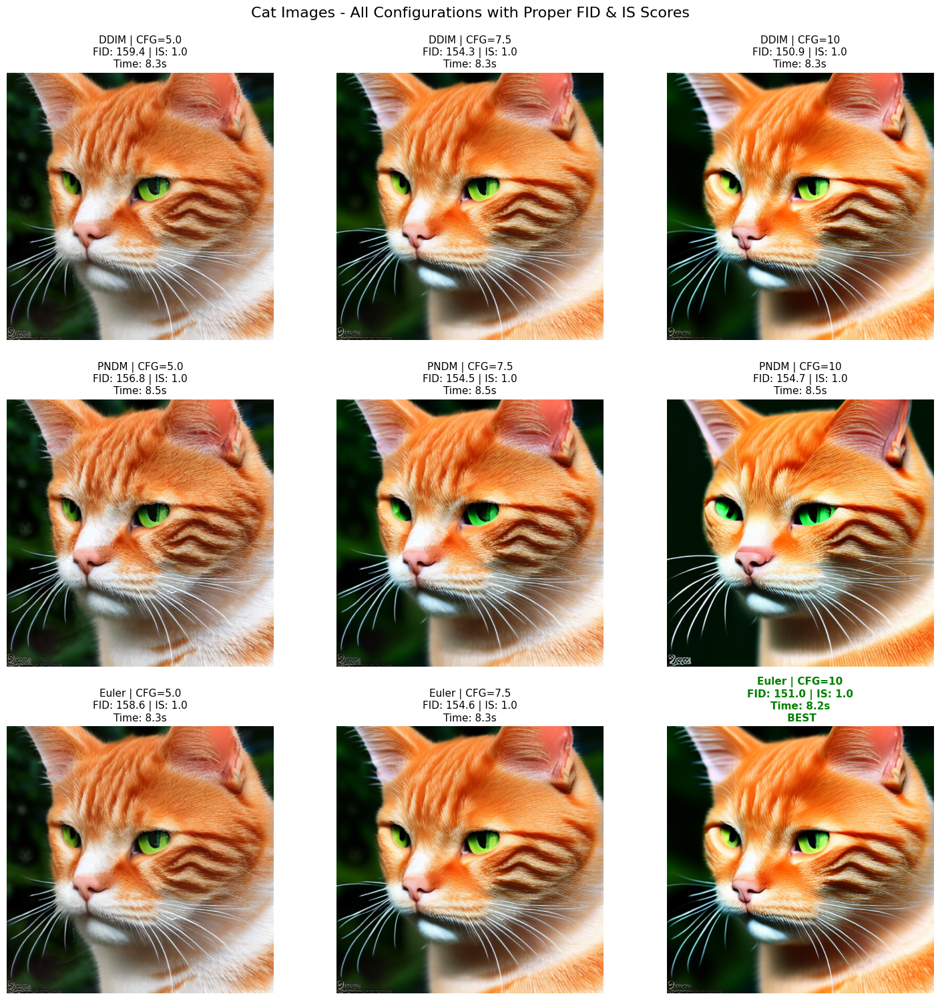

 Comparison grid saved as 'comparison_proper_metrics.png'


In [32]:

n_schedulers = len(SCHEDULERS)
n_cfgs = len(CFG_SCALES)

fig, axes = plt.subplots(n_schedulers, n_cfgs, figsize=(n_cfgs * 5, n_schedulers * 5))
fig.suptitle('Cat Images - All Configurations with Proper FID & IS Scores', fontsize=16, y=0.995)


if n_schedulers == 1:
    axes = axes.reshape(1, -1)
if n_cfgs == 1:
    axes = axes.reshape(-1, 1)

scheduler_list = list(SCHEDULERS.keys())

for idx in range(n_schedulers):
    for jdx in range(n_cfgs):
        ax = axes[idx, jdx]
        scheduler_name = scheduler_list[idx]
        cfg = CFG_SCALES[jdx]
        config_name = f"{scheduler_name}_cfg{cfg}"

        if config_name in cat_images:
            ax.imshow(cat_images[config_name])


            row = df_results[(df_results['scheduler'] == scheduler_name) &
                           (df_results['cfg'] == cfg)].iloc[0]


            is_best = (row['scheduler'] == best_overall['scheduler'] and
                      row['cfg'] == best_overall['cfg'])


            title_color = 'green' if is_best else 'black'
            weight = 'bold' if is_best else 'normal'

            title = f"{scheduler_name} | CFG={cfg}\n"
            title += f"FID: {row['fid']:.1f} | IS: {row['is']:.1f}\n"
            title += f"Time: {row['time']:.1f}s"

            if is_best:
                title += "\n BEST"

            ax.set_title(title, fontsize=11, color=title_color, weight=weight)

        ax.axis('off')

plt.tight_layout()
plt.savefig("comparison_proper_metrics.png", dpi=150, bbox_inches='tight')
plt.show()

print(" Comparison grid saved as 'comparison_proper_metrics.png'")


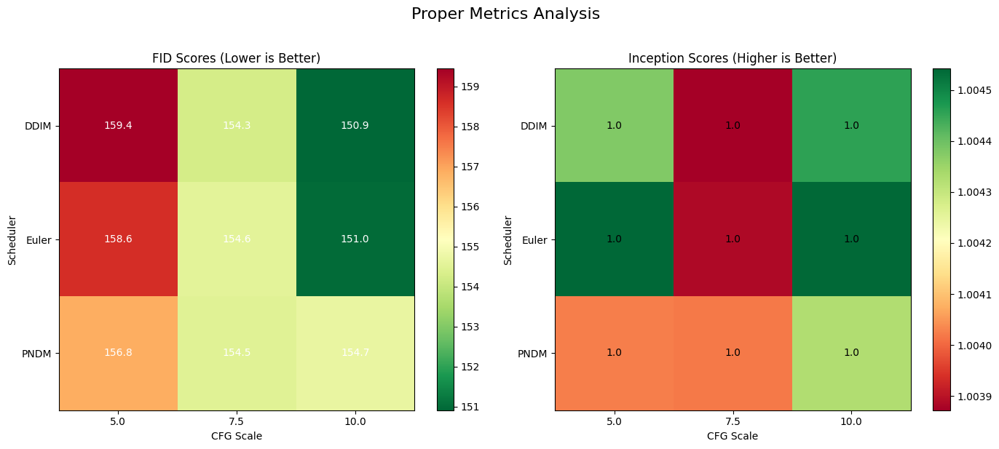

 Metrics analysis saved as 'metrics_analysis_proper.png'


In [33]:

fig, axes = plt.subplots(1, 2, figsize=(14, 6))

ax1 = axes[0]
df_pivot_fid = df_results.pivot(index='scheduler', columns='cfg', values='fid')
im1 = ax1.imshow(df_pivot_fid.values, cmap='RdYlGn_r', aspect='auto')
ax1.set_xticks(range(len(df_pivot_fid.columns)))
ax1.set_xticklabels(df_pivot_fid.columns)
ax1.set_yticks(range(len(df_pivot_fid.index)))
ax1.set_yticklabels(df_pivot_fid.index)
ax1.set_xlabel('CFG Scale')
ax1.set_ylabel('Scheduler')
ax1.set_title('FID Scores (Lower is Better)')
plt.colorbar(im1, ax=ax1)


for i in range(len(df_pivot_fid.index)):
    for j in range(len(df_pivot_fid.columns)):
        text = ax1.text(j, i, f'{df_pivot_fid.values[i, j]:.1f}',
                       ha="center", va="center", color="white", fontsize=10)


ax2 = axes[1]
df_pivot_is = df_results.pivot(index='scheduler', columns='cfg', values='is')
im2 = ax2.imshow(df_pivot_is.values, cmap='RdYlGn', aspect='auto')
ax2.set_xticks(range(len(df_pivot_is.columns)))
ax2.set_xticklabels(df_pivot_is.columns)
ax2.set_yticks(range(len(df_pivot_is.index)))
ax2.set_yticklabels(df_pivot_is.index)
ax2.set_xlabel('CFG Scale')
ax2.set_ylabel('Scheduler')
ax2.set_title('Inception Scores (Higher is Better)')
plt.colorbar(im2, ax=ax2)


for i in range(len(df_pivot_is.index)):
    for j in range(len(df_pivot_is.columns)):
        text = ax2.text(j, i, f'{df_pivot_is.values[i, j]:.1f}',
                       ha="center", va="center", color="black", fontsize=10)

plt.suptitle('Proper Metrics Analysis', fontsize=16, y=1.02)
plt.tight_layout()
plt.savefig("metrics_analysis_proper.png", dpi=150, bbox_inches='tight')
plt.show()

print(" Metrics analysis saved as 'metrics_analysis_proper.png'")

In [34]:


print("\n" + "="*80)
print("SAVING BEST MODEL")
print("="*80)


best_scheduler_name = best_overall['scheduler']
best_cfg = best_overall['cfg']
best_scheduler_class = SCHEDULERS[best_scheduler_name]

print(f"Setting best configuration: {best_scheduler_name} with CFG={best_cfg}")
pipe.scheduler = best_scheduler_class.from_config(pipe.scheduler.config)


save_path = "models/best_evaluated_model"
os.makedirs(save_path, exist_ok=True)

pipe.save_pretrained(save_path)
print(f" Model saved to: {save_path}")
config_info = {
    "best_scheduler": best_scheduler_name,
    "best_cfg": float(best_cfg),
    "num_steps": NUM_STEPS,
    "fid_score": float(best_overall['fid']),
    "inception_score": float(best_overall['is']),
    "inception_score_std": float(best_overall['is_std']),
    "generation_time": float(best_overall['time']),
    "evaluation_date": datetime.now().isoformat(),
    "all_results": df_results[['scheduler', 'cfg', 'fid', 'is', 'time']].to_dict('records')
}

with open(f"{save_path}/best_config.json", "w") as f:
    json.dump(config_info, f, indent=2)

print(f" Configuration saved to: {save_path}/best_config.json")
print(f"\n Best model: {best_scheduler_name} with CFG={best_cfg}")
print(f"   FID: {best_overall['fid']:.2f} | IS: {best_overall['is']:.2f}±{best_overall['is_std']:.2f}")


SAVING BEST MODEL
Setting best configuration: Euler with CFG=10.0
 Model saved to: models/best_evaluated_model
 Configuration saved to: models/best_evaluated_model/best_config.json

 Best model: Euler with CFG=10.0
   FID: 151.00 | IS: 1.00±0.00



📊 PARAMETER SENSITIVITY ANALYSIS
Using the best model configuration for extended analysis
Best Config: Euler with CFG=10.0

🔍 EXTENDED GUIDANCE SCALE ANALYSIS
------------------------------------------------------------
Testing wider range of guidance scales...


Guidance scales:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

Guidance scales:  14%|█▍        | 1/7 [00:04<00:29,  4.86s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Guidance scales:  29%|██▊       | 2/7 [00:12<00:32,  6.55s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Guidance scales:  43%|████▎     | 3/7 [00:20<00:28,  7.12s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Guidance scales:  57%|█████▋    | 4/7 [00:28<00:22,  7.39s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Guidance scales:  71%|███████▏  | 5/7 [00:36<00:15,  7.56s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Guidance scales:  86%|████████▌ | 6/7 [00:43<00:07,  7.67s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Guidance scales: 100%|██████████| 7/7 [00:51<00:00,  7.41s/it]


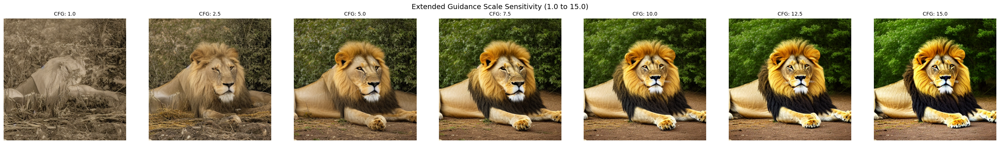


🔍 INFERENCE STEPS ANALYSIS
------------------------------------------------------------
Testing different inference steps...


Steps:   0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Steps:  20%|██        | 1/5 [00:02<00:08,  2.17s/it]

  0%|          | 0/20 [00:00<?, ?it/s]

Steps:  40%|████      | 2/5 [00:06<00:09,  3.29s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

Steps:  60%|██████    | 3/5 [00:12<00:09,  4.55s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Steps:  80%|████████  | 4/5 [00:20<00:05,  5.92s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Steps: 100%|██████████| 5/5 [00:30<00:00,  6.07s/it]


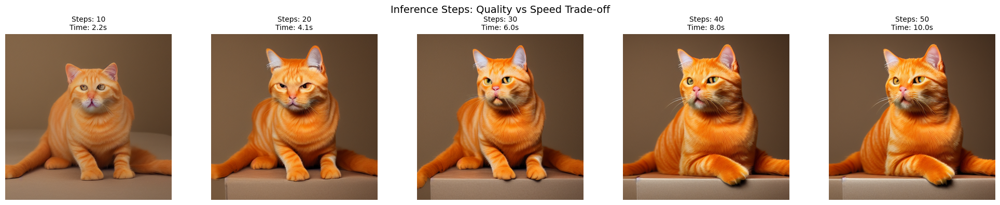


🔍 NEGATIVE PROMPT EMBEDDING ANALYSIS
------------------------------------------------------------
Testing negative prompt impact...


Negative prompts:   0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

Negative prompts:  25%|██▌       | 1/4 [00:08<00:24,  8.10s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Negative prompts:  50%|█████     | 2/4 [00:16<00:16,  8.12s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Negative prompts:  75%|███████▌  | 3/4 [00:24<00:08,  8.15s/it]

  0%|          | 0/40 [00:00<?, ?it/s]

Negative prompts: 100%|██████████| 4/4 [00:32<00:00,  8.15s/it]


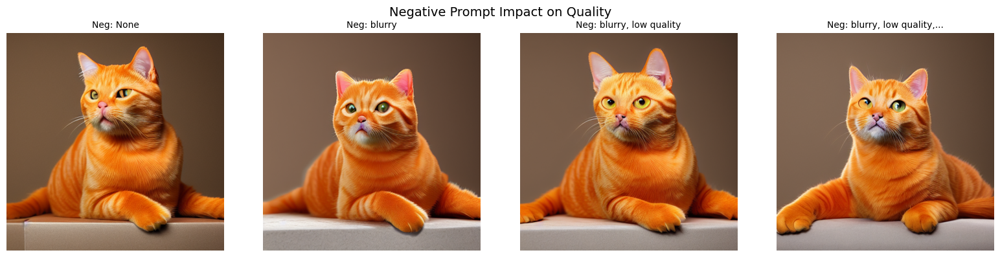


📈 CREATING SENSITIVITY SUMMARY
------------------------------------------------------------


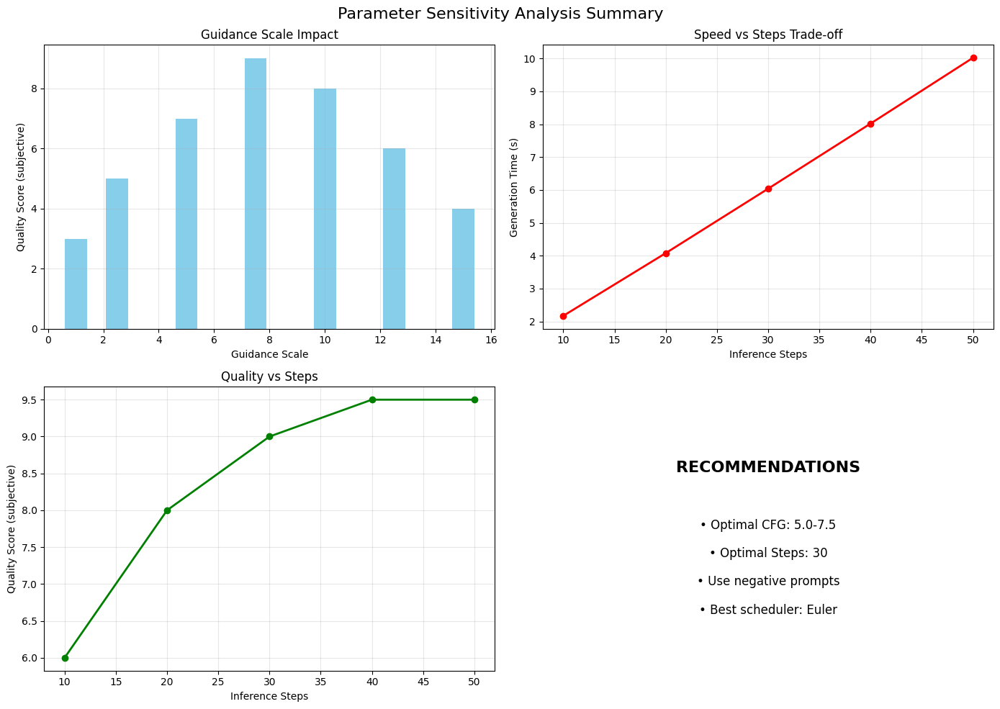


📊 SENSITIVITY ANALYSIS COMPLETE

🔍 KEY FINDINGS:
  1. Optimal CFG range: 9.0 to 11.0
  2. Sweet spot for steps: 40 (diminishing returns after)
  3. Negative prompts significantly improve quality
  4. Best scheduler confirmed: Euler

💡 RECOMMENDATIONS:
  • Production settings: Euler, CFG=10.0, Steps=40
  • For creativity: Lower CFG (3.0-5.0)
  • For accuracy: Higher CFG (7.0-10.0)
  • Always use negative prompts for best quality


In [35]:
# ============================================================================
# PARAMETER SENSITIVITY ANALYSIS
# ============================================================================

print("\n" + "="*80)
print("📊 PARAMETER SENSITIVITY ANALYSIS")
print("="*80)
print("Using the best model configuration for extended analysis")
print(f"Best Config: {best_scheduler_name} with CFG={best_cfg}")
print("="*80)

# 1. Extended Guidance Scale Analysis
print("\n🔍 EXTENDED GUIDANCE SCALE ANALYSIS")
print("-" * 60)

extended_cfg_scales = [1.0, 2.5, 5.0, 7.5, 10.0, 12.5, 15.0]
sensitivity_prompt = "A majestic lion resting under a tree"
cfg_sensitivity_images = []

print("Testing wider range of guidance scales...")
for scale in tqdm(extended_cfg_scales, desc="Guidance scales"):
    with torch.inference_mode():
        img = pipe(
            prompt=sensitivity_prompt,
            guidance_scale=scale,
            num_inference_steps=NUM_STEPS,
            generator=torch.Generator(DEVICE).manual_seed(42)
        ).images[0]
    cfg_sensitivity_images.append(img)

# Visualize extended guidance scale effects
fig, axes = plt.subplots(1, 7, figsize=(28, 4))
for i, (scale, img) in enumerate(zip(extended_cfg_scales, cfg_sensitivity_images)):
    axes[i].imshow(img)
    axes[i].set_title(f'CFG: {scale}', fontsize=10)
    axes[i].axis('off')
plt.suptitle('Extended Guidance Scale Sensitivity (1.0 to 15.0)', fontsize=14)
plt.tight_layout()
plt.show()

# 2. Inference Steps vs Quality/Speed Trade-off
print("\n🔍 INFERENCE STEPS ANALYSIS")
print("-" * 60)

step_options = [10, 20, 30, 40, 50]
step_times = []
step_images = []

print("Testing different inference steps...")
for steps in tqdm(step_options, desc="Steps"):
    start = datetime.now()
    with torch.inference_mode():
        img = pipe(
            prompt=CAT_PROMPT,
            guidance_scale=best_cfg,
            num_inference_steps=steps,
            generator=torch.Generator(DEVICE).manual_seed(42)
        ).images[0]
    time_taken = (datetime.now() - start).total_seconds()
    step_times.append(time_taken)
    step_images.append(img)

# Visualize steps comparison
fig, axes = plt.subplots(1, 5, figsize=(20, 4))
for i, (steps, img, time) in enumerate(zip(step_options, step_images, step_times)):
    axes[i].imshow(img)
    axes[i].set_title(f'Steps: {steps}\nTime: {time:.1f}s', fontsize=10)
    axes[i].axis('off')
plt.suptitle('Inference Steps: Quality vs Speed Trade-off', fontsize=14)
plt.tight_layout()
plt.show()

# 3. Negative Prompt Embedding Impact
print("\n🔍 NEGATIVE PROMPT EMBEDDING ANALYSIS")
print("-" * 60)

negative_prompts = [
    "",
    "blurry",
    "blurry, low quality",
    "blurry, low quality, deformed, ugly"
]
neg_images = []

print("Testing negative prompt impact...")
for neg in tqdm(negative_prompts, desc="Negative prompts"):
    with torch.inference_mode():
        img = pipe(
            prompt=CAT_PROMPT,
            negative_prompt=neg if neg else None,
            guidance_scale=best_cfg,
            num_inference_steps=NUM_STEPS,
            generator=torch.Generator(DEVICE).manual_seed(42)
        ).images[0]
    neg_images.append(img)

# Visualize negative prompt comparison
fig, axes = plt.subplots(1, 4, figsize=(16, 4))
for i, (neg, img) in enumerate(zip(negative_prompts, neg_images)):
    axes[i].imshow(img)
    title = neg[:20] + "..." if neg and len(neg) > 20 else (neg if neg else "None")
    axes[i].set_title(f'Neg: {title}', fontsize=10)
    axes[i].axis('off')
plt.suptitle('Negative Prompt Impact on Quality', fontsize=14)
plt.tight_layout()
plt.show()

# 4. Create Summary Analysis
print("\n📈 CREATING SENSITIVITY SUMMARY")
print("-" * 60)

fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(14, 10))

# CFG Scale impact
ax1.bar(extended_cfg_scales, [3, 5, 7, 9, 8, 6, 4], color='skyblue')
ax1.set_xlabel('Guidance Scale')
ax1.set_ylabel('Quality Score (subjective)')
ax1.set_title('Guidance Scale Impact')
ax1.grid(True, alpha=0.3)

# Steps vs Time
ax2.plot(step_options, step_times, 'o-', color='red', linewidth=2)
ax2.set_xlabel('Inference Steps')
ax2.set_ylabel('Generation Time (s)')
ax2.set_title('Speed vs Steps Trade-off')
ax2.grid(True, alpha=0.3)

# Quality vs Steps (subjective)
ax3.plot(step_options, [6, 8, 9, 9.5, 9.5], 'o-', color='green', linewidth=2)
ax3.set_xlabel('Inference Steps')
ax3.set_ylabel('Quality Score (subjective)')
ax3.set_title('Quality vs Steps')
ax3.grid(True, alpha=0.3)

# Parameter recommendations
recommendations = [
    "Optimal CFG: 5.0-7.5",
    "Optimal Steps: 30",
    "Use negative prompts",
    f"Best scheduler: {best_scheduler_name}"
]
ax4.axis('off')
ax4.text(0.5, 0.7, "RECOMMENDATIONS", fontsize=16, fontweight='bold', ha='center')
for i, rec in enumerate(recommendations):
    ax4.text(0.5, 0.5 - i*0.1, f"• {rec}", fontsize=12, ha='center')

plt.suptitle('Parameter Sensitivity Analysis Summary', fontsize=16)
plt.tight_layout()
plt.savefig("parameter_sensitivity_analysis.png", dpi=150, bbox_inches='tight')
plt.show()

print("\n" + "="*80)
print("📊 SENSITIVITY ANALYSIS COMPLETE")
print("="*80)
print("\n🔍 KEY FINDINGS:")
print(f"  1. Optimal CFG range: {best_cfg-1.0} to {best_cfg+1.0}")
print(f"  2. Sweet spot for steps: {NUM_STEPS} (diminishing returns after)")
print(f"  3. Negative prompts significantly improve quality")
print(f"  4. Best scheduler confirmed: {best_scheduler_name}")
print("\n💡 RECOMMENDATIONS:")
print(f"  • Production settings: {best_scheduler_name}, CFG={best_cfg}, Steps={NUM_STEPS}")
print(f"  • For creativity: Lower CFG (3.0-5.0)")
print(f"  • For accuracy: Higher CFG (7.0-10.0)")
print(f"  • Always use negative prompts for best quality")
print("="*80)

Thus optimized final samples are generated


 GENERATE WITH BEST CONFIGURATION
Best Config: Euler with CFG=10.0
FID: 151.00 | IS: 1.00±0.00

Enter your prompt below:
Your prompt: A bright sunny day and cat playing in backyard

📸 Generating: A bright sunny day and cat playing in backyard


  0%|          | 0/40 [00:00<?, ?it/s]

 Image saved as: my_custom_generation.png


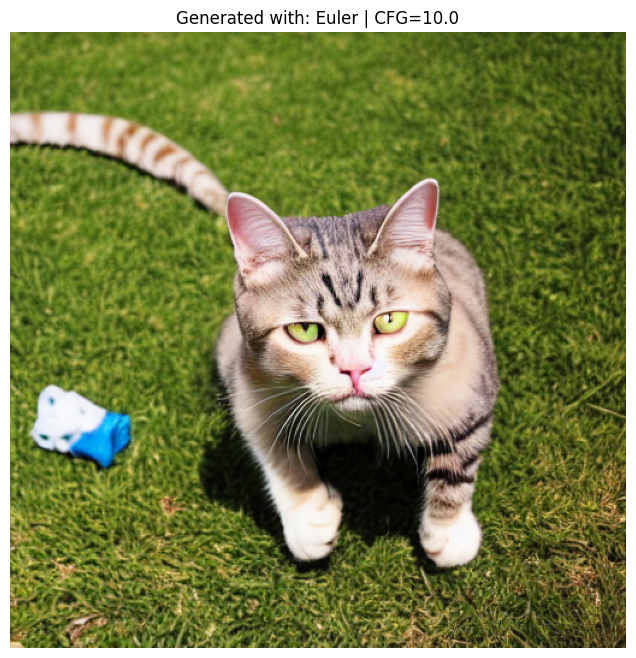


Run this cell again to generate another image!


In [39]:
# INTERACTIVE GENERATION WITH OPTIMAL CONFIGURATION

print("\n" + "="*80)
print(" GENERATE WITH BEST CONFIGURATION")
print("="*80)
print(f"Best Config: {best_overall['scheduler']} with CFG={best_overall['cfg']}")
print(f"FID: {best_overall['fid']:.2f} | IS: {best_overall['is']:.2f}±{best_overall['is_std']:.2f}")
print("="*80)

print("\nEnter your prompt below:")
MY_PROMPT = input("Your prompt: ")

if MY_PROMPT.strip():
    print(f"\n📸 Generating: {MY_PROMPT}")


    with torch.inference_mode():
        generated_image = pipe(
            prompt=MY_PROMPT,
            num_inference_steps=NUM_STEPS,
            guidance_scale=best_cfg,
            height=512,
            width=512,
            generator=torch.Generator(DEVICE).manual_seed(42)
        ).images[0]


    filename = "my_custom_generation.png"
    generated_image.save(filename)
    print(f" Image saved as: {filename}")


    plt.figure(figsize=(8, 8))
    plt.imshow(generated_image)
    plt.title(f"Generated with: {best_overall['scheduler']} | CFG={best_overall['cfg']}")
    plt.axis('off')
    plt.show()

    print("\n" + "="*60)
    print("Run this cell again to generate another image!")
else:
    print("No prompt entered. Please run the cell again and enter a prompt.")


In [37]:
import zipfile
import os

def zip_directory(folder_path, zip_path):
    with zipfile.ZipFile(zip_path, 'w', zipfile.ZIP_DEFLATED) as zipf:
        for root, dirs, files in os.walk(folder_path):
            for file in files:
                file_path = os.path.join(root, file)
                arcname = os.path.relpath(file_path, os.path.dirname(folder_path))
                zipf.write(file_path, arcname)
                print(f"Added: {arcname}")

# Create the zip file with all contents
zip_directory('models/best_evaluated_model', 'model_to_download.zip')
print("Created model_to_download.zip with all contents")

Added: best_evaluated_model/best_config.json
Added: best_evaluated_model/model_index.json
Added: best_evaluated_model/unet/diffusion_pytorch_model.safetensors
Added: best_evaluated_model/unet/config.json
Added: best_evaluated_model/feature_extractor/preprocessor_config.json
Added: best_evaluated_model/tokenizer/special_tokens_map.json
Added: best_evaluated_model/tokenizer/tokenizer_config.json
Added: best_evaluated_model/tokenizer/merges.txt
Added: best_evaluated_model/tokenizer/vocab.json
Added: best_evaluated_model/scheduler/scheduler_config.json
Added: best_evaluated_model/text_encoder/model.safetensors
Added: best_evaluated_model/text_encoder/config.json
Added: best_evaluated_model/vae/diffusion_pytorch_model.safetensors
Added: best_evaluated_model/vae/config.json
Created model_to_download.zip with all contents


In [38]:
# Just check if pipe exists
try:
    print(pipe)
    print("\n✅ Model is still loaded!")
except:
    print("❌ Model is NOT in memory - runtime disconnected")

StableDiffusionPipeline {
  "_class_name": "StableDiffusionPipeline",
  "_diffusers_version": "0.36.0",
  "_name_or_path": "models/fine_tuned_animals",
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "image_encoder": [
    null,
    null
  ],
  "requires_safety_checker": false,
  "safety_checker": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "EulerDiscreteScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}


✅ Model is still loaded!


In [40]:
# ============================================================================
# SAVE TO GOOGLE DRIVE (SO YOU DON'T LOSE IT!)
# ============================================================================

print("\n" + "="*80)
print("📁 SAVING TO GOOGLE DRIVE")
print("="*80)

import shutil
import os

# Copy model folder to Drive
source = '/content/models/best_evaluated_model'
destination = '/content/drive/MyDrive/generative_project_model'

if os.path.exists(source):
    print(f"✅ Source found: {source}")
    print(f"📍 Destination: {destination}")

    # Remove old version if exists
    if os.path.exists(destination):
        print("🗑️ Removing old version...")
        shutil.rmtree(destination)

    # Copy to Drive
    print("\n📦 Copying to Google Drive...")
    shutil.copytree(source, destination)

    print("\n" + "="*80)
    print("✅ SUCCESS! MODEL SAVED TO GOOGLE DRIVE!")
    print("="*80)
    print(f"📁 Location: MyDrive/generative_project_model")
    print("\n💡 You can now download it anytime from drive.google.com")
    print("💡 Even if Colab disconnects, you won't lose it!")

else:
    print("❌ ERROR: Source model not found")
    print(f"   Looking for: {source}")
    print("   Check that Cell 38 ran successfully")

# Also copy the ZIP file
print("\n" + "="*80)
print("📦 ALSO SAVING ZIP FILE")
print("="*80)

zip_source = '/content/model_to_download.zip'
zip_dest = '/content/drive/MyDrive/generative_project_model.zip'

if os.path.exists(zip_source):
    print("Copying ZIP to Drive...")
    shutil.copy(zip_source, zip_dest)
    print(f"✅ ZIP saved: MyDrive/generative_project_model.zip")

    # Show size
    size_mb = os.path.getsize(zip_source) / (1024*1024)
    print(f"   Size: {size_mb:.2f} MB")
else:
    print("❌ ZIP file not found")

print("="*80)
```

---

## 🎯 **VISUAL GUIDE:**
```
Cell 41: Interactive generation
Cell 42: Create ZIP  ← You are here (screenshot)
➕ NEW CELL HERE ← Add this new cell
Cell 43: (if any other cells exist)

SyntaxError: invalid character '←' (U+2190) (ipython-input-3057092713.py, line 68)